In [293]:
######### FUNCTIONS ###########
runInitSeurat <- function(counts, metadata) {
    ap = new("seurat", raw.data = counts)
    ap = Setup(ap, project = "Autophagy", min.cells = 3, min.genes =1000, is.expr = 0.5, names.field = 1, 
           meta.data = metadata, names.delim="_")
    ap = MeanVarPlot(ap, y.cutoff = 1, x.low.cutoff = 1,fxn.x = expMean,fxn.y = logVarDivMean)
    cat("Number of variable genes: ", length(ap@var.genes))
    return(ap)
}

getEdgerCPM <- function(counts, metadata, remove.zeros=F, normalized.lib.sizes=T, prior.count = 1) {
    counts.edgeR = DGEList(counts, remove.zeros=remove.zeros)
    counts.edgeR = calcNormFactors(counts.edgeR, remove.zeros=remove.zeros)
    counts.tmm = data.frame(cpm(counts.edgeR, normalized.lib.sizes = normalized.lib.sizes, prior.count=prior.count))
    counts.tmm = log(1+counts.tmm)
    return(counts.tmm)    
}

getDesignMatrixFromMetaData<- function(metadata, use.batch=F, do.full=F) {
    metadata.edgeR = metadata
    CellType = factor(metadata.edgeR$CellType)
    GenoType = factor(metadata.edgeR$GenoType)
    GenoType = relevel(GenoType, "WT")
    Stimulation = factor(metadata$Stimulation)
    if ("NoStim" %in% metadata$Stimulation)
        {Stimulation = relevel(Stimulation, "NoStim")}
    Replicate = factor(metadata$Replicate)
    Batch = factor(metadata.edgeR$Batch)
    if (use.batch==T)
        design <- model.matrix(~0+Batch+GenoType+Stimulation)
    else
        design <- model.matrix(~GenoType+Stimulation)
    if (do.full==T)
        design <- model.matrix(~0+CellType:GenoType:Stimulation, data = metadata)
    return(design)
}

getGLMFit <- function(counts, design, metadata) {
    counts.edgeR = filterCpmRank(counts, 5000, "sum")
    dge = DGEList(counts, remove.zeros=T)
    dge = estimateGLMCommonDisp(dge, design)
    dge = estimateGLMTrendedDisp(dge, design)
    dge = estimateGLMTagwiseDisp(dge, design)
    fit = glmFit(dge, design)
    return(fit)
}
      
getGLMQLFit <- function(counts, design, metadata) {
    counts.edgeR = filterCpmRank(counts, 5000, "sum")
    dge = DGEList(counts, remove.zeros=T)
    dge = estimateGLMCommonDisp(dge, design)
    dge = estimateGLMTrendedDisp(dge, design)
    dge = estimateGLMTagwiseDisp(dge, design)
    fit = glmQLFit(dge, design, robust=T)
    return(fit)
}
      
filterCpmRank <- function(counts, keep.genes=5000, method="var") {
  # keep genes that rank highest in some measure of cross-sample CPM
  rank.metrics = c("var","max","sum")
  keep.genes = min(keep.genes, nrow(counts))
  if (method %in% rank.metrics) {
    ranks = apply(cpm(counts), 1, method)
    ranks = sort(ranks, decreasing=TRUE)
    genes = names(ranks)[1:keep.genes]
    keep.rows = (rownames(counts) %in% genes)
    return (counts[keep.rows,])
  } else {
    print(paste("Unrecognized method", method, "- skipping filter"))
    return (counts)
  }
}
        
plotRawCounts <- function(gene, counts, metadata) {
        qplot(x=colnames(counts), y = as.numeric(unname(counts[gene,])), xlab = colnames(counts),
              color = metadata$Donor, fill=metadata$Stimulation) + 
    geom_bar(stat="identity") +
    theme(axis.text.x = element_text(angle = 90))  +
    labs(x="Sample", y="Counts", title=gene, fill="Stim", color="Donor")  +
    scale_color_manual(values = c("black", "grey", "white"))
    }
        
plotDoubleDiffScatterPlot <- function(singlediff1, singlediff2, doublediff, label1, label2, return.table=F) {
    logFC.table = data.frame(matrix(nrow=nrow(singlediff1), ncol=2))
    rownames(logFC.table)=rownames(singlediff1)
    logFC.table[,1]=singlediff1$logFC
    logFC.table[rownames(singlediff2),2]=singlediff2$logFC
    plottable = logFC.table
    plottable$ddFDR = doublediff[rownames(plottable),]$FDR
    plottable$Significant=ifelse(plottable$ddFDR < 0.05, "Yes", "No")
    plottable$name=rownames(plottable)
    colnames(plottable)=c("KO", "WT", "ddFDR", "Significant", "Gene")
    p <-ggplot(plottable, aes(x=WT,y=KO, color=ddFDR)) + geom_point() + 
#    scale_color_manual(values=c("No" = "lightgrey","Yes" = "firebrick4")) +
    scale_color_gradient(low="firebrick4", high="lightgrey")+
    theme_bw() + geom_text_repel(data=subset(plottable, ddFDR < 0.05),
            aes(x=WT, y=KO,label=Gene), color="black", force=7) + geom_vline(xintercept=0)+geom_hline(yintercept=0)+
            labs(x=label1, y = label2, color="FDR")
    print(p)
    if (return.table==T)
        return(plottable)
    }


In [138]:
plotRawCountsMetadata <- function(gene, counts, metadata) {
        qplot(x=colnames(counts), y = as.numeric(unname(counts[gene,])), xlab = colnames(counts),
              color = metadata$Donor, fill=metadata$Stimulation) + 
    geom_bar(stat="identity") +
    theme(axis.text.x = element_text(angle = 90))  +
    labs(x="Sample", y="Counts", title=gene)
#scale_fill_manual(values = c("black", "grey", "white"))
    }

In [2]:
numSigGenes <- function (lrt_obj, adjust) {
    topTags(lrt_obj, n=NULL, p.value=0.05, adjust.method = adjust) %>% nrow
}
addEntrezToLRT <- function(lrt) {
    lrt$table$gene = rownames(lrt_obj$table)
    match_id = match(lrt$table$gene, ENTREZ$symbol)
    lrt$table$Entrez = ENTREZ$gene_id[match_id]
    }
goanaQuick <- function(lrt) {
    goana(lrt, geneid = lrt$table$Entrez, FDR = 0.05, species = "Hs")
}
keggaQuick <- function(lrt) {
    kegga(lrt, geneid = lrt$table$Entrez, FDR = 0.05, species = "Hs")
}

In [548]:
plotPathways <- function(dzym_ke, ptitle) {
topke_dzym = topKEGG(dzym_ke, n=50) %>% tibble::rownames_to_column("pathid") %>% 
    filter(N<500 & pmin(P.Up, P.Down) < 10e-6)
    
topke_dzym_dn = topke_dzym %>% filter(Up < Down) %>% dplyr::select(pathid, Pathway, Down, P.Down, Up, P.Up) %>% dplyr::arrange(P.Down) 
topke_dzym_up = topke_dzym %>% filter(Up > Down) %>%dplyr::select(pathid, Pathway, Up, P.Up, Down, P.Down) %>% dplyr::arrange(P.Up)
p = ggplot() + 
    geom_bar(data = topke_dzym_up,aes(x=factor(Pathway, levels=rev(Pathway)), y=Up, fill = log(P.Up), width=.8) , stat="identity") +
    geom_bar(data = topke_dzym_up,aes(x=factor(Pathway, levels=rev(Pathway)), y=-Down, fill = log(P.Down), width=.8), stat = "identity") +
    labs(x="Pathway", y="Number of Sig. Genes", fill="log(p-Val)", title=paste("Pathways more up- than down-regulated in\n", ptitle)) + 
    coord_flip()
    plot(p)
    
    p = ggplot() + 
        geom_bar(data = topke_dzym_dn,aes(x=factor(Pathway, levels=rev(Pathway)), y=Up, fill = log(P.Up), width=.8),  stat="identity") +
        geom_bar(data = topke_dzym_dn,aes(x=factor(Pathway, levels=rev(Pathway)), y=-Down, fill = log(P.Down) width=.8,) stat = "identity") +
        labs(x="Pathway", y="Number of Sig. Genes", fill="log(p-Val)", title=paste("Pathways more down- than up-regulated in\n",ptitle)) + 
         coord_flip()
    plot(p)
       
}

getGenesOfPathways <- function(pathway, lrt) {
    print(k1[k1$PathwayID==pathway,]$Description)
#    if (!is.na(lrt)) {
        glist = intersect(
            ENTREZ[ENTREZ$gene_id %in% k2[k2$PathwayID==pathway,]$GeneID,]$symbol,
            topTags(lrt, n=NULL, p.value = 0.05, adjust.method="BH") %>% rownames
            )
      #  }
 #   else 
 #       glist=ENTREZ[ENTREZ$gene_id %in% k2[k2$PathwayID==pathway,]$GeneID,]$symbol
 #   print(glist)
    return(glist)
    }

ERROR: Error in parse(text = x, srcfile = src): <text>:16:111: unexpected symbol
15:         geom_bar(data = topke_dzym_dn,aes(x=factor(Pathway, levels=rev(Pathway)), y=Up, fill = log(P.Up), width=.8),  stat="identity") +
16:         geom_bar(data = topke_dzym_dn,aes(x=factor(Pathway, levels=rev(Pathway)), y=-Down, fill = log(P.Down) width
                                                                                                                  ^


In [4]:
        
plotRawCounts <- function(gene, counts, metadata) {
        qplot(x=colnames(counts), y = as.numeric(unname(counts[gene,])), xlab = colnames(counts)) + 
    geom_bar(stat="identity") +
    theme(axis.text.x = element_text(angle = 90))  +
    labs(x="Sample", y="Counts", title=gene)
#scale_fill_manual(values = c("black", "grey", "white"))
    }

In [5]:
library(pheatmap)
library(edgeR)
library(ggplot2)
library(dplyr)
library(tidyr)
library(stringr)
library(org.Hs.eg.db)
library(ggrepel)

Loading required package: limma
Warning message:
: package ‘ggplot2’ was built under R version 3.3.2
Attaching package: ‘dplyr’

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union

Warning message:
: package ‘tidyr’ was built under R version 3.3.2Warning message:
: package ‘stringr’ was built under R version 3.3.2Loading required package: AnnotationDbi
Loading required package: stats4
Loading required package: BiocGenerics
Loading required package: parallel

Attaching package: ‘BiocGenerics’

The following objects are masked from ‘package:parallel’:

    clusterApply, clusterApplyLB, clusterCall, clusterEvalQ,
    clusterExport, clusterMap, parApply, parCapply, parLapply,
    parLapplyLB, parRapply, parSapply, parSapplyLB

The following objects are masked from ‘package:dplyr’:

    combine, intersect, setdiff, union

The following object is masked from ‘package:limma’:



In [6]:
library(Seurat)

Loading required package: cowplot

Attaching package: ‘cowplot’

The following object is masked from ‘package:ggplot2’:

    ggsave


Attaching package: ‘Seurat’

The following object is masked from ‘package:dplyr’:

    arrange



In [7]:
counts = read.delim("counts.total.dat", header=T, row.names =1)
metadata = read.delim("metadata.tsv", header=T, row.names=1)


In [225]:
qc.table = data.matrix(read.delim("qc.table.dat", header=T, row.names=1)) %>% data.frame

In [220]:
t(qc.table)

,D1_DZymosan_1,D1_DZymosan_2,D1_NS_1,D1_NS_2,D1_Pam3Cys_1,D1_Pam3Cys_2,D1_Peanut_1,D1_Peanut_2,D1_S300_1,D1_S300_2,⋯,D3_NS_1,D3_NS_2,D3_Pam3Cys_1,D3_Pam3Cys_2,D3_Peanut_1,D3_Peanut_2,D3_S300_1,D3_S300_2,D3_Zymosan_1,D3_Zymosan_2
Total.Read.Pairs,12485048.50000,14880905.50000,7635551.500000,13109849.00000,16326128.00000,12313660.50000,11324019.500000,8180345.50000,13038806.50000,15326912.50000,⋯,7703991.50000,7853196.50000,14671221.50000,12261691.00000,14680179.50000,9273755.50000,15596062.00000,10719117.00000,12745044.50000,13628313.50000
Percent.Assigned.Reads.of.Total,60.12891,87.49150,50.072206,70.43850,66.23810,72.27004,51.579300,68.84697,54.90388,69.47594,⋯,82.91320,66.23490,64.56958,84.62709,78.30770,68.01632,85.48252,75.73298,68.50511,87.36519
Number.of.Genes,19533.00000,26184.00000,15890.000000,29747.00000,21784.00000,21130.00000,19186.000000,23335.00000,19287.00000,21786.00000,⋯,26105.00000,19846.00000,20890.00000,24377.00000,26017.00000,20800.00000,25801.00000,21207.00000,20509.00000,23459.00000
Percent.Exonic.of.Assigned,17.54497,42.65391,4.412158,22.24395,21.18433,26.16851,6.439431,20.69705,12.15573,25.25052,⋯,40.37474,19.09256,19.07419,37.98172,31.54479,21.80213,39.29267,30.73423,22.89568,40.67904
Percent.Intronic.of.Assigned,68.59521,20.58482,89.791438,58.75026,62.90393,54.30193,86.457767,61.85614,77.83974,56.34882,⋯,23.65448,65.26793,65.91431,33.19337,45.46423,61.05497,30.67998,46.67583,58.75643,23.74156
Percent.Intragenic.of.Assigned,86.14017,63.23873,94.203596,80.99422,84.08826,80.47043,92.897198,82.55319,89.99546,81.59935,⋯,64.02922,84.36049,84.98850,71.17508,77.00902,82.85709,69.97265,77.41007,81.65211,64.42060
Percent.Intergenic.of.Assigned,13.85983,36.76127,5.796404,19.00578,15.91174,19.52957,7.102802,17.44681,10.00454,18.40065,⋯,35.97078,15.63951,15.01150,28.82492,22.99098,17.14291,30.02735,22.58993,18.34789,35.57940


In [221]:
colnames(qc.table)

[1] "Total.Read.Pairs"                "Percent.Assigned.Reads.of.Total"
[3] "Number.of.Genes"                 "Percent.Exonic.of.Assigned"     
[5] "Percent.Intronic.of.Assigned"    "Percent.Intragenic.of.Assigned" 
[7] "Percent.Intergenic.of.Assigned"

In [218]:
#qc.table$Donor=metadata[rownames(qc.table),"Donor"]
#qc.table$Stimulation=metadata[rownames(qc.table),"Stimulation"]

Warning message:
In qc.table$Donor = metadata[rownames(qc.table), "Donor"]: Coercing LHS to a list

In [226]:
qc.table$Sample = rownames(qc.table)

In [227]:
qc.table.long = gather(qc.table, Sample)
colnames(qc.table.long)=c("Sample", "Metric", "Value")

In [228]:
rp = qc.table.long %>% filter(Metric=="Total.Read.Pairs")

In [230]:
metadata$Donor

[1] Donor_1 Donor_1 Donor_1 Donor_1 Donor_1 Donor_1 Donor_1 Donor_1 Donor_1
[10] Donor_1 Donor_1 Donor_1 Donor_2 Donor_2 Donor_2 Donor_2 Donor_2 Donor_2
[19] Donor_2 Donor_2 Donor_2 Donor_2 Donor_2 Donor_2 Donor_3 Donor_3 Donor_3
[28] Donor_3 Donor_3 Donor_3 Donor_3 Donor_3 Donor_3 Donor_3 Donor_3 Donor_3
Levels: Donor_1 Donor_2 Donor_3

In [237]:
qc.table.long$Metric %>% unique

[1] "Total.Read.Pairs"                "Percent.Assigned.Reads.of.Total"
[3] "Number.of.Genes"                 "Percent.Exonic.of.Assigned"     
[5] "Percent.Intronic.of.Assigned"    "Percent.Intragenic.of.Assigned" 
[7] "Percent.Intergenic.of.Assigned"

In [277]:
plotMetricBarplot <- function(qc.table.long, metric, metadata) {
ggplot(qc.table.long %>% filter(Metric==metric), aes(x=Sample, y=Value, fill=metadata$Stimulation, 
                                                                           color=metadata$Donor))+
geom_bar(stat="identity") + scale_color_manual(values=c("white", "grey", "black")) +
labs(title=""metric"", x="Sample", y=metric, fill="Stimulation", color="Donor")  + coord_flip()
    }



In [275]:
plotMetricBarplot2 <- function(qc.table.long, metric, metadata) {
ggplot(qc.table.long, aes(x=Sample, y=Value, fill=Metric, color=metadata$Donor))+
geom_bar(stat="identity") + scale_color_manual(values=c("white", "grey", "black")) +
labs(title=metric, x="Sample", y=metric, fill="Stimulation", color="Donor") 
    }



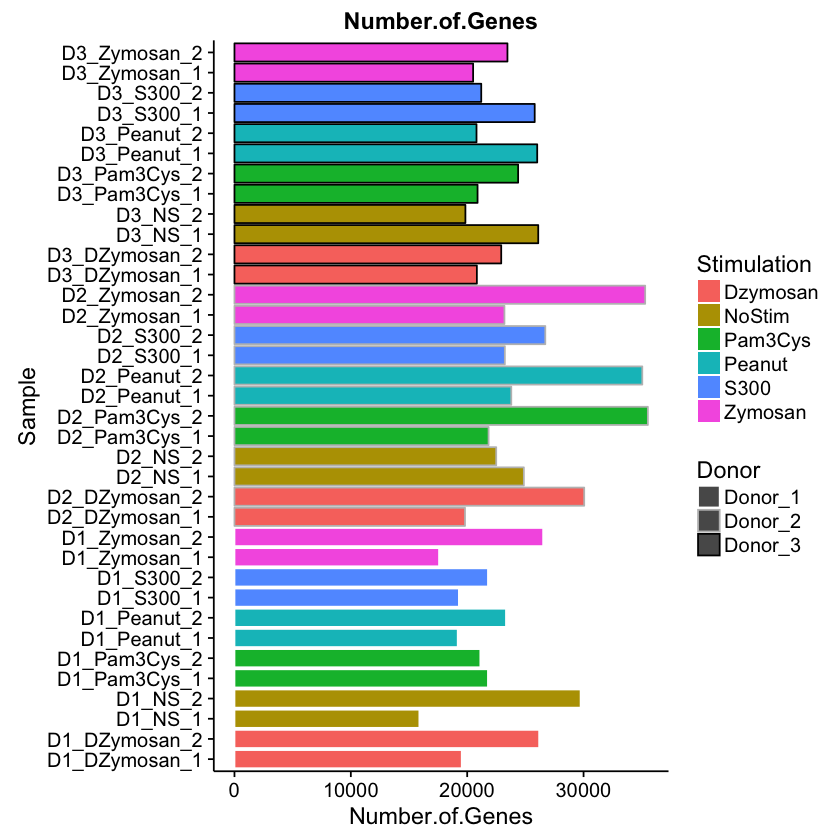

In [278]:
plotMetricBarplot(qc.table.long, 'Number.of.Genes', metadata)

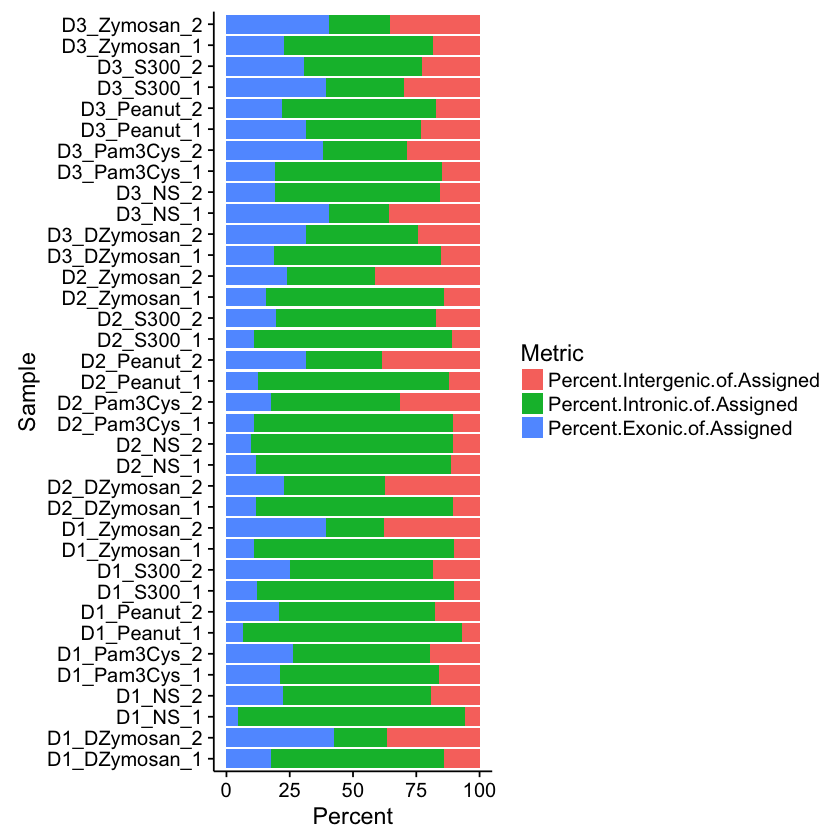

In [269]:
ggplot(qc.table.percent, aes(x=Sample, y=Value, 
                             fill=factor(Metric, levels=rev(c('Percent.Exonic.of.Assigned'
                                                          ,'Percent.Intronic.of.Assigned',
                                                          'Percent.Intergenic.of.Assigned')))))+
geom_bar(stat="identity") + 
labs(fill="Metric", y="Percent")+ coord_flip()

In [250]:
qc.table.percent = qc.table.long %>% filter(Metric %in% c('Percent.Exonic.of.Assigned','Percent.Intronic.of.Assigned','Percent.Intergenic.of.Assigned'))

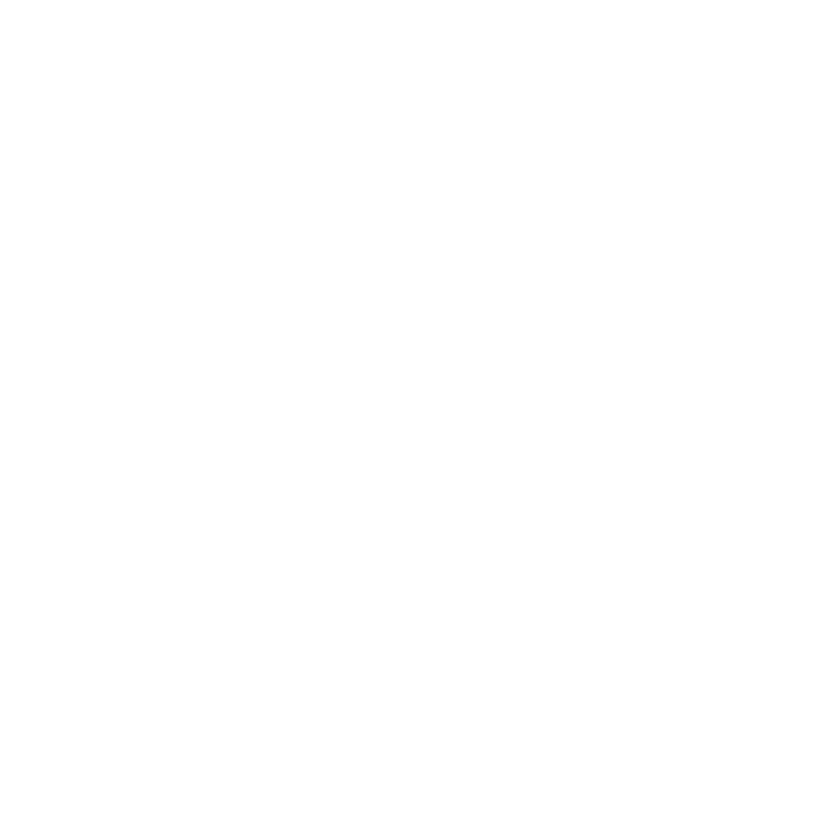

In [252]:
plotMetricBarplot2(qc.table.percent, "Percent.Assigned.Reads.of.Total", metadata)

In [8]:
colnames(counts)
counts = counts[,-c(37)]
colnames(counts)
metadata = metadata[colnames(counts),]
rownames(metadata)

[1] "D1_DZymosan_1"      "D1_DZymosan_2"      "D1_NS_1"           
 [4] "D1_NS_2"            "D1_Pam3Cys_1"       "D1_Pam3Cys_2"      
 [7] "D1_Peanut_1"        "D1_Peanut_2"        "D1_S300_1"         
[10] "D1_S300_2"          "D1_Zymosan_1"       "D1_Zymosan_2"      
[13] "D2_DZymosan_1"      "D2_DZymosan_2"      "D2_NS_1"           
[16] "D2_NS_2"            "D2_Pam3Cys_1"       "D2_Pam3Cys_2"      
[19] "D2_Peanut_1"        "D2_Peanut_2"        "D2_S300_1"         
[22] "D2_S300_2"          "D2_Zymosan_1"       "D2_Zymosan_2"      
[25] "D3_DZymosan_1"      "D3_DZymosan_2"      "D3_NS_1"           
[28] "D3_NS_2"            "D3_Pam3Cys_1"       "D3_Pam3Cys_2"      
[31] "D3_Peanut_1"        "D3_Peanut_2"        "D3_S300_1"         
[34] "D3_S300_2"          "D3_Zymosan_1"       "D3_Zymosan_2"      
[37] "Undetermined_S0_R1"

[1] "D1_DZymosan_1" "D1_DZymosan_2" "D1_NS_1"       "D1_NS_2"      
 [5] "D1_Pam3Cys_1"  "D1_Pam3Cys_2"  "D1_Peanut_1"   "D1_Peanut_2"  
 [9] "D1_S300_1"     "D1_S300_2"     "D1_Zymosan_1"  "D1_Zymosan_2" 
[13] "D2_DZymosan_1" "D2_DZymosan_2" "D2_NS_1"       "D2_NS_2"      
[17] "D2_Pam3Cys_1"  "D2_Pam3Cys_2"  "D2_Peanut_1"   "D2_Peanut_2"  
[21] "D2_S300_1"     "D2_S300_2"     "D2_Zymosan_1"  "D2_Zymosan_2" 
[25] "D3_DZymosan_1" "D3_DZymosan_2" "D3_NS_1"       "D3_NS_2"      
[29] "D3_Pam3Cys_1"  "D3_Pam3Cys_2"  "D3_Peanut_1"   "D3_Peanut_2"  
[33] "D3_S300_1"     "D3_S300_2"     "D3_Zymosan_1"  "D3_Zymosan_2"

[1] "D1_DZymosan_1" "D1_DZymosan_2" "D1_NS_1"       "D1_NS_2"      
 [5] "D1_Pam3Cys_1"  "D1_Pam3Cys_2"  "D1_Peanut_1"   "D1_Peanut_2"  
 [9] "D1_S300_1"     "D1_S300_2"     "D1_Zymosan_1"  "D1_Zymosan_2" 
[13] "D2_DZymosan_1" "D2_DZymosan_2" "D2_NS_1"       "D2_NS_2"      
[17] "D2_Pam3Cys_1"  "D2_Pam3Cys_2"  "D2_Peanut_1"   "D2_Peanut_2"  
[21] "D2_S300_1"     "D2_S300_2"     "D2_Zymosan_1"  "D2_Zymosan_2" 
[25] "D3_DZymosan_1" "D3_DZymosan_2" "D3_NS_1"       "D3_NS_2"      
[29] "D3_Pam3Cys_1"  "D3_Pam3Cys_2"  "D3_Peanut_1"   "D3_Peanut_2"  
[33] "D3_S300_1"     "D3_S300_2"     "D3_Zymosan_1"  "D3_Zymosan_2"

In [9]:
metadata

,Donor,Stimulation
D1_DZymosan_1,Donor_1,Dzymosan
D1_DZymosan_2,Donor_1,Dzymosan
D1_NS_1,Donor_1,NoStim
D1_NS_2,Donor_1,NoStim
D1_Pam3Cys_1,Donor_1,Pam3Cys
D1_Pam3Cys_2,Donor_1,Pam3Cys
D1_Peanut_1,Donor_1,Peanut
D1_Peanut_2,Donor_1,Peanut
D1_S300_1,Donor_1,S300
D1_S300_2,Donor_1,S300


In [10]:
library(corrplot)

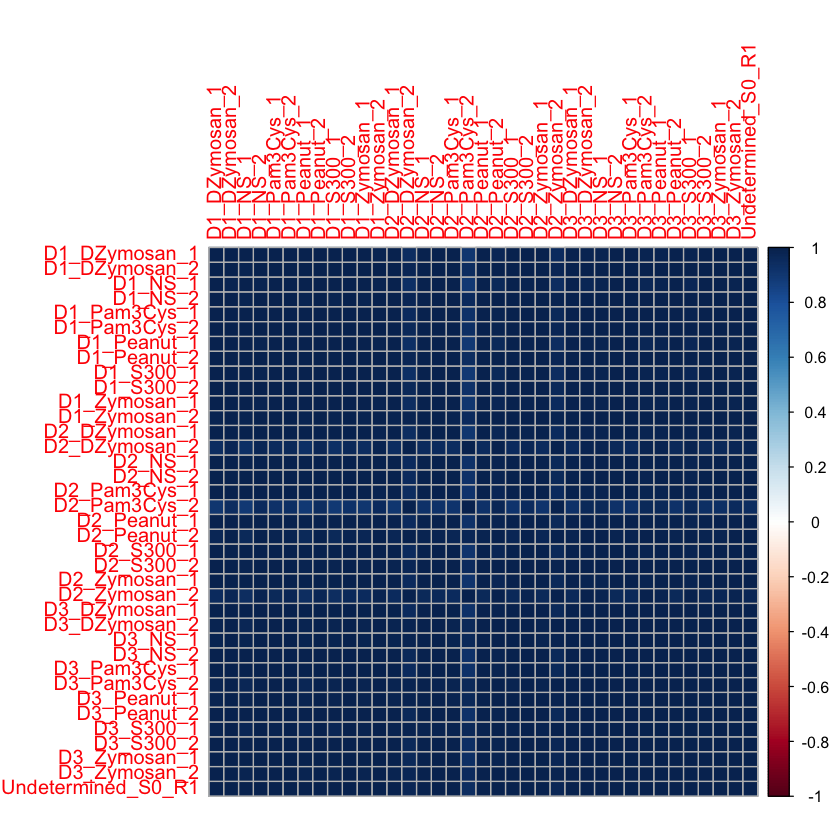

In [133]:
cpm = read.delim("counts.cpm.dat", header=T, row.names=1)

corrplot(cor(cpm), method="square", )

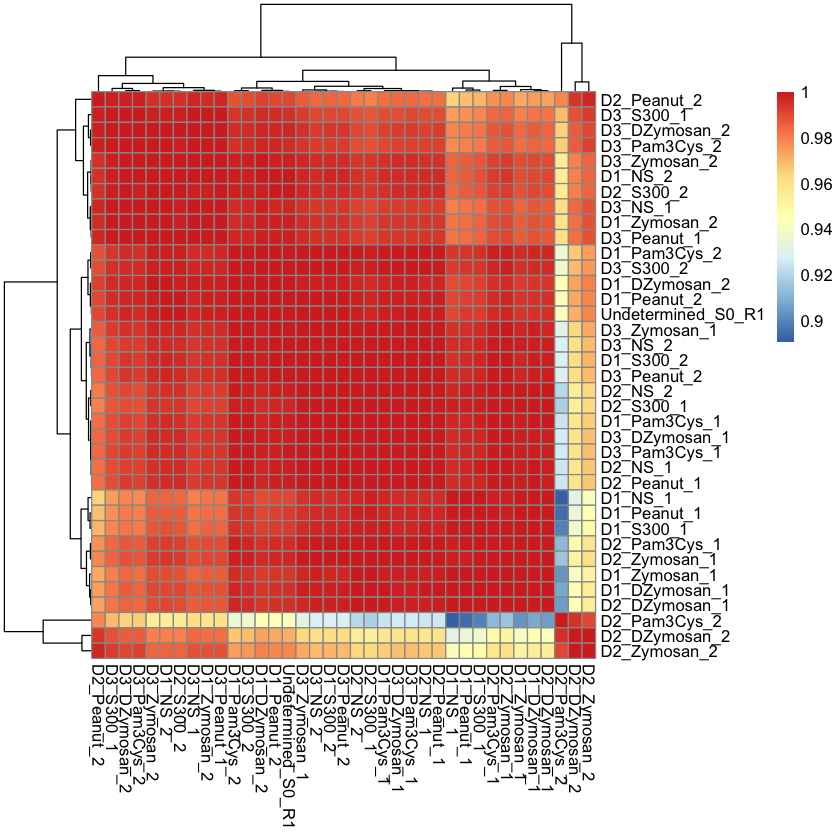

In [135]:
pheatmap(cor(cpm))

In [134]:
?corrplot

In [12]:
int_genes = counts[rowSums(counts) > 200,] %>% rownames

In [13]:
counts_spl = counts[int_genes,]

In [14]:
corr_genes = cor(t(counts_spl))

In [15]:
max(corr_genes["ALDH1A2",])

[1] 1

In [16]:
seu = new("seurat",raw.data=counts)
seu = Setup(seu,project="Peanuts",min.cells = 3,min.genes = 500,is.expr=1,names.field = 1, names.delim="_", meta.data = metadata) 

[1] "Performing log-normalization"
[1] "Scaling data matrix"
  |======================================================================| 100%


[1] "Calculating gene dispersion"
  |======================================================================| 100%


[1] 108

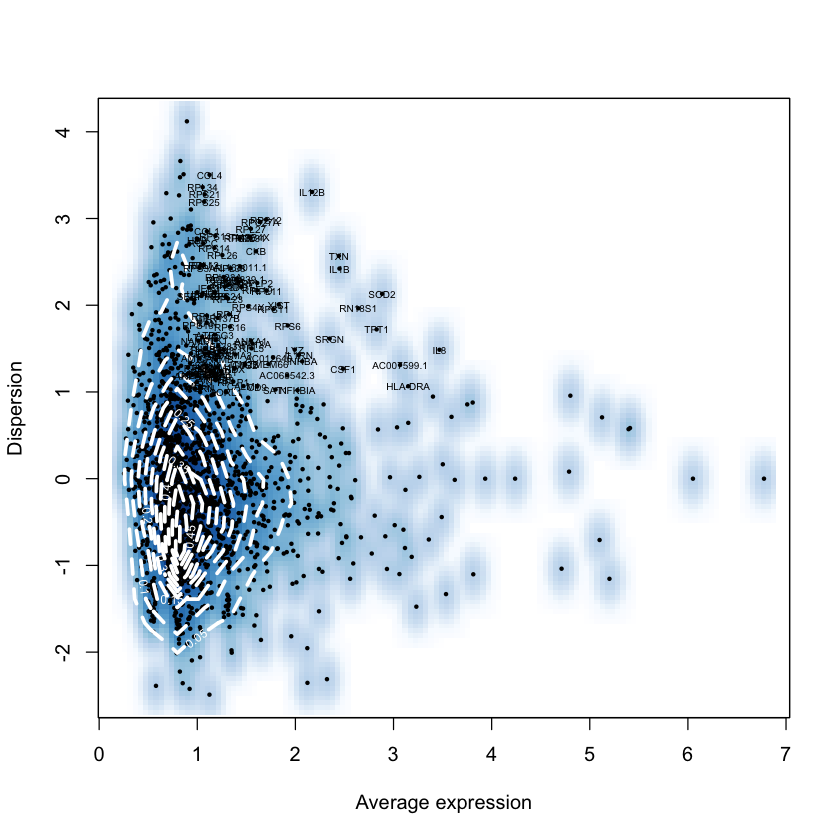

In [17]:
seu = MeanVarPlot(seu, y.cutoff = 1, x.low.cutoff = 1,fxn.x = expMean,fxn.y = logVarDivMean)
length(seu@var.genes)

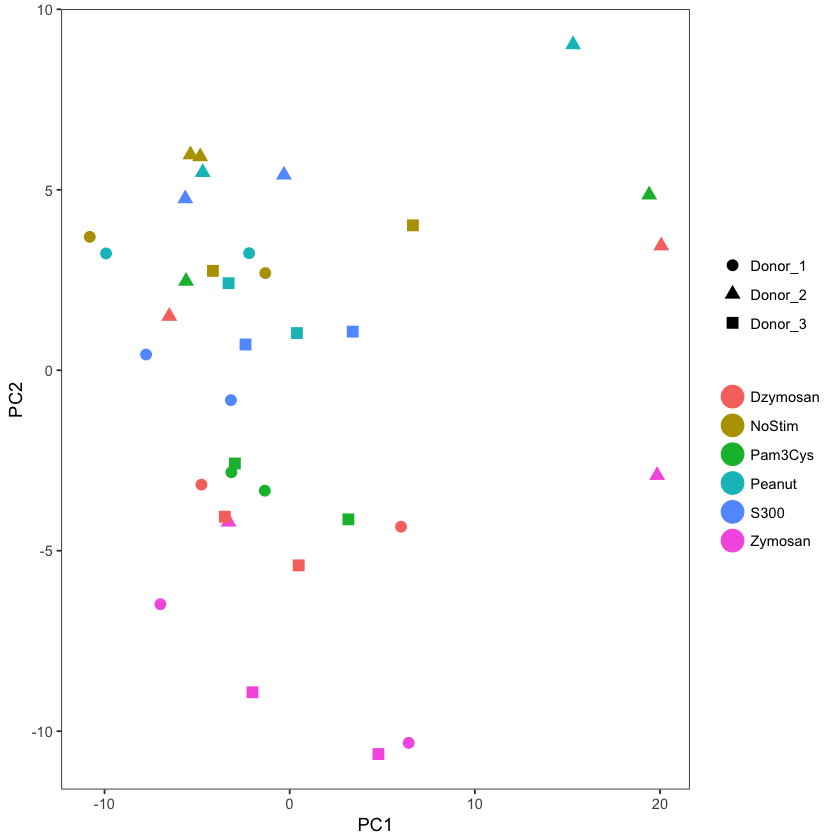

In [18]:
seu = PCA(seu, do.print=F)
PCAPlot(seu, group.by="Stimulation", pt.shape="Donor")


In [19]:
seu = ProjectPCA(seu, do.print=F)


  |======================================================================| 100%


In [20]:
?ProjectPCA

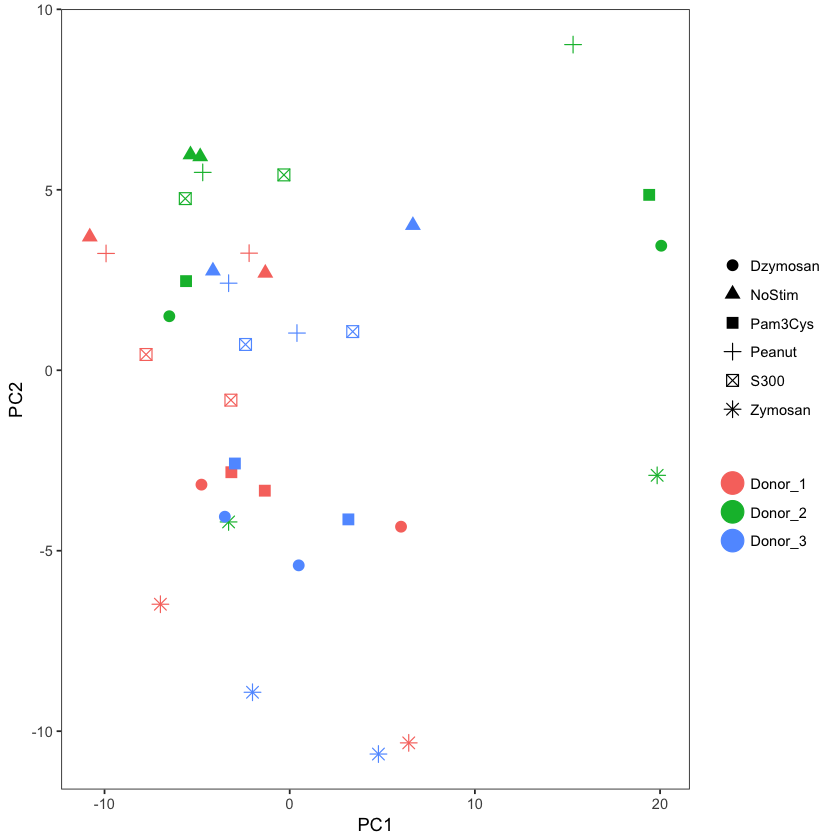

In [21]:
PCAPlot(seu, pt.shape="Stimulation", group.by="Donor")

In [22]:
seu=RunTSNE(seu,dims.use = 1:10, add.iter=2000, perplexity =4)

sigma summary: Min. : 0.3651 |1st Qu. : 0.495 |Median : 0.5585 |Mean : 0.608 |3rd Qu. : 0.7364 |Max. : 0.8936 |
Epoch: Iteration #100 error is: 19.6171361834904
Epoch: Iteration #200 error is: 2.3909965869359
Epoch: Iteration #300 error is: 1.88571370589046
Epoch: Iteration #400 error is: 1.67461266816892
Epoch: Iteration #500 error is: 1.42932353134178
Epoch: Iteration #600 error is: 1.23929782990497
Epoch: Iteration #700 error is: 0.986037353139021
Epoch: Iteration #800 error is: 0.822882047532508
Epoch: Iteration #900 error is: 0.66318017208488
Epoch: Iteration #1000 error is: 0.596981277415877
sigma summary: Min. : 0.3651 |1st Qu. : 0.495 |Median : 0.5585 |Mean : 0.608 |3rd Qu. : 0.7364 |Max. : 0.8936 |
Epoch: Iteration #100 error is: 0.585963319339703
Epoch: Iteration #200 error is: 0.573204979490832
Epoch: Iteration #300 error is: 0.545433724997968
Epoch: Iteration #400 error is: 0.519441026839953
Epoch: Iteration #500 error is: 0.499513014989844
Epoch: Iteration #600 error is: 0

In [23]:
?TSNEPlot

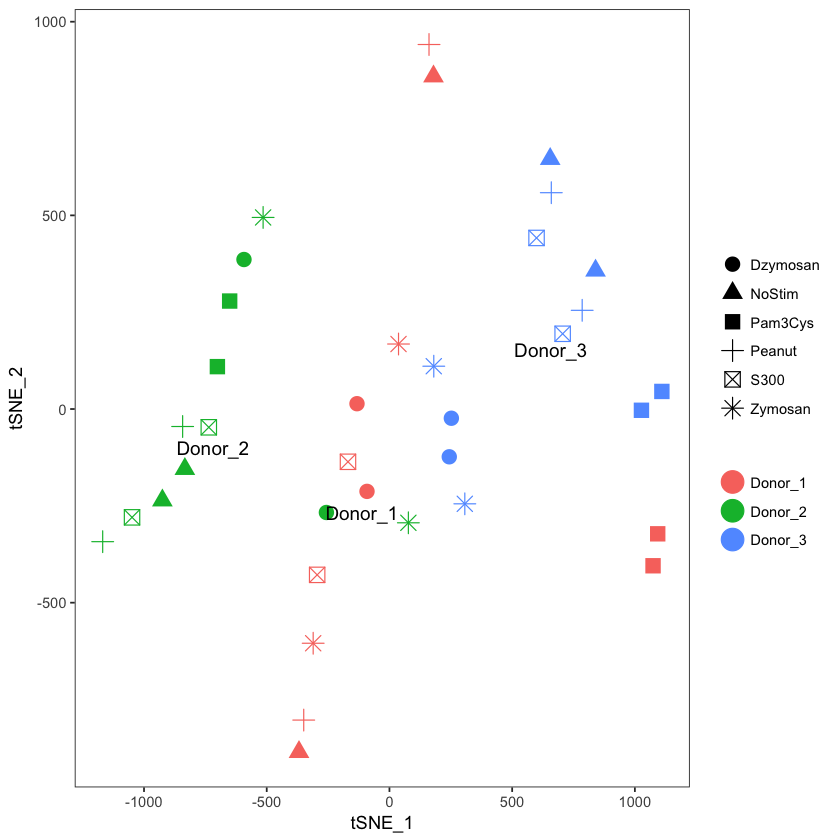

In [279]:
TSNEPlot(seu, group.by="Donor", pt.shape="Stimulation", pt.size=4, do.label=T)

In [25]:

Stimulation = factor(metadata$Stimulation)
Stimulation = relevel(Stimulation, "NoStim")
Donor = factor(metadata$Donor)


In [26]:
dge = DGEList(counts)
dge = calcNormFactors(dge, method = "TMM")
design <- model.matrix(~0+Donor+Stimulation)
rownames(design) = rownames(metadata)

design

,DonorDonor_1,DonorDonor_2,DonorDonor_3,StimulationDzymosan,StimulationPam3Cys,StimulationPeanut,StimulationS300,StimulationZymosan
D1_DZymosan_1,1,0,0,1,0,0,0,0
D1_DZymosan_2,1,0,0,1,0,0,0,0
D1_NS_1,1,0,0,0,0,0,0,0
D1_NS_2,1,0,0,0,0,0,0,0
D1_Pam3Cys_1,1,0,0,0,1,0,0,0
D1_Pam3Cys_2,1,0,0,0,1,0,0,0
D1_Peanut_1,1,0,0,0,0,1,0,0
D1_Peanut_2,1,0,0,0,0,1,0,0
D1_S300_1,1,0,0,0,0,0,1,0
D1_S300_2,1,0,0,0,0,0,1,0


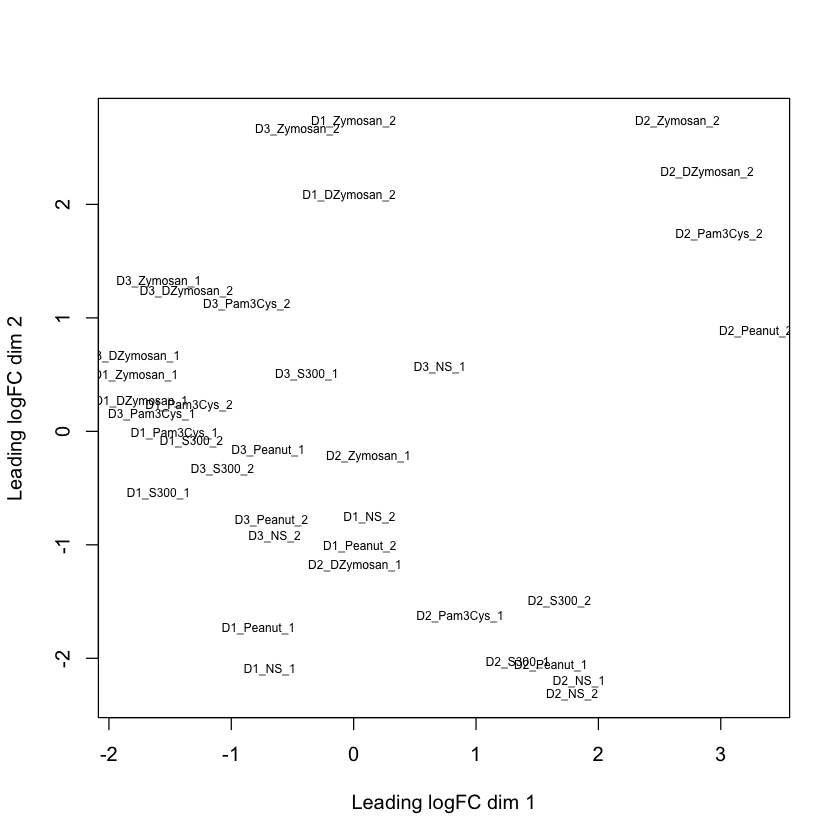

In [27]:
plotMDS(dge, cex = 0.6)

In [28]:

dge = estimateGLMCommonDisp(dge, design)
dge = estimateGLMTrendedDisp(dge, design)
dge = estimateGLMTagwiseDisp(dge, design)
fit = glmFit(dge, design)


In [29]:
str(dge)

Formal class 'DGEList' [package "edgeR"] with 1 slot
  ..@ .Data:List of 9
  .. ..$ : int [1:49915, 1:36] 0 47 13 0 1 252 9 0 0 0 ...
  .. .. ..- attr(*, "dimnames")=List of 2
  .. .. .. ..$ : chr [1:49915] "5S_rRNA" "7SK" "A1BG" "A1CF" ...
  .. .. .. ..$ : chr [1:36] "D1_DZymosan_1" "D1_DZymosan_2" "D1_NS_1" "D1_NS_2" ...
  .. ..$ :'data.frame':	36 obs. of  3 variables:
  .. .. ..$ group       : Factor w/ 1 level "1": 1 1 1 1 1 1 1 1 1 1 ...
  .. .. ..$ lib.size    : num [1:36] 3371406 9376899 1352951 4538224 5073884 ...
  .. .. ..$ norm.factors: num [1:36] 0.902 1.039 0.429 1.185 0.93 ...
  .. ..$ : num 0.292
  .. ..$ : num [1:49915] -1.229 4.596 2.392 -0.461 0.354 ...
  .. ..$ : chr "bin.spline"
  .. ..$ : num [1:49915] 3.091 0.185 0.235 1.446 0.603 ...
  .. ..$ : num 0.141
  .. ..$ : num 10
  .. ..$ : num [1:49915] 103.4525 0.1312 0.0876 2.0416 0.3274 ...


In [30]:
counts.tmm = getEdgerCPM(counts, metadata, remove.zeros=T, normalized.lib.sizes = T, prior.count = 0.25)

Removing 4018 rows with all zero counts


In [31]:
data.frame(t(counts.tmm["NFKB1", ]), t(counts.tmm["ALDH1A2",]))

,NFKB1,ALDH1A2
D1_DZymosan_1,6.100844,4.2996116
D1_DZymosan_2,6.439028,4.3034761
D1_NS_1,5.481837,0.0000000
D1_NS_2,5.857029,1.3322261
D1_Pam3Cys_1,6.472474,0.3533291
D1_Pam3Cys_2,6.509308,0.1912311
D1_Peanut_1,5.626200,1.2335734
D1_Peanut_2,5.706102,0.9565326
D1_S300_1,5.803596,6.0800319
D1_S300_2,6.052433,6.3937770


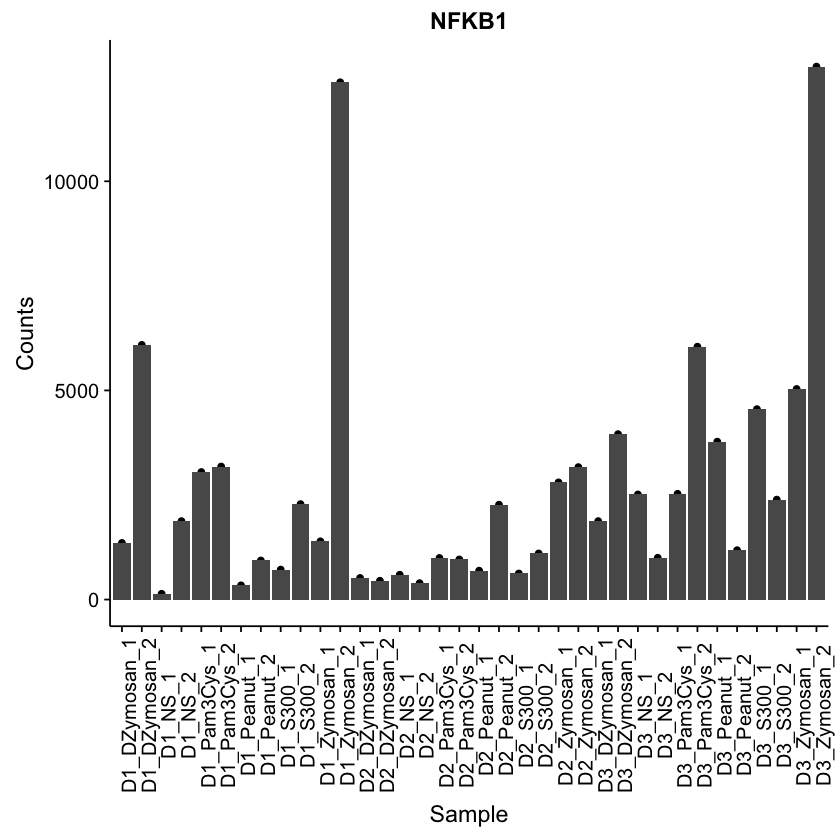

In [32]:
plotRawCounts("NFKB1", counts)

In [33]:
design %>% colnames %>% as.list

[[1]]
[1] "DonorDonor_1"

[[2]]
[1] "DonorDonor_2"

[[3]]
[1] "DonorDonor_3"

[[4]]
[1] "StimulationDzymosan"

[[5]]
[1] "StimulationPam3Cys"

[[6]]
[1] "StimulationPeanut"

[[7]]
[1] "StimulationS300"

[[8]]
[1] "StimulationZymosan"

In [34]:
dzym_lrt <- glmLRT(fit, coef=4)


In [35]:
pam3cys_lrt <- glmLRT(fit, coef=5)
peanut_lrt <- glmLRT(fit, coef=6)
s300_lrt <- glmLRT(fit, coef=7)
zym_lrt <- glmLRT(fit, coef=8)

In [36]:
s300_dzym_vs_pam3cys_zym_lrt <- glmLRT(fit, contrast=c(0,0,0,1,-1,0,1,-1))

In [37]:
lrtlist_singlediff = list(dzym_lrt, pam3cys_lrt, peanut_lrt, s300_lrt, zym_lrt)

In [315]:
list_names = list("dzym", "pam3cys", "peanut", "s300", "zym")

In [38]:
numSigGenes(s300_lrt, "BH")

[1] 341

In [39]:
df_stims = data.frame(matrix(nrow=5, ncol=1))
rownames(df_stims) = c("d-Zymosan", "Pam3cys", "Peanut", "s300", "Zymosan")
colnames(df_stims)=c("nSigGenes_DiffExp")

In [40]:
df_stims$nSigGenes_DiffExp = unlist(lapply(lrtlist_singlediff, numSigGenes, adjust="BH"))

In [41]:
df_stims = df_stims %>% add_rownames
df_stims

Warning message:
: Deprecated, use tibble::rownames_to_column() instead.

rowname,nSigGenes_DiffExp
d-Zymosan,2471
Pam3cys,657
Peanut,0
s300,341
Zymosan,3233


In [42]:
str(df_stims)

Classes ‘tbl_df’, ‘tbl’ and 'data.frame':	5 obs. of  2 variables:
 $ rowname          : chr  "d-Zymosan" "Pam3cys" "Peanut" "s300" ...
 $ nSigGenes_DiffExp: int  2471 657 0 341 3233


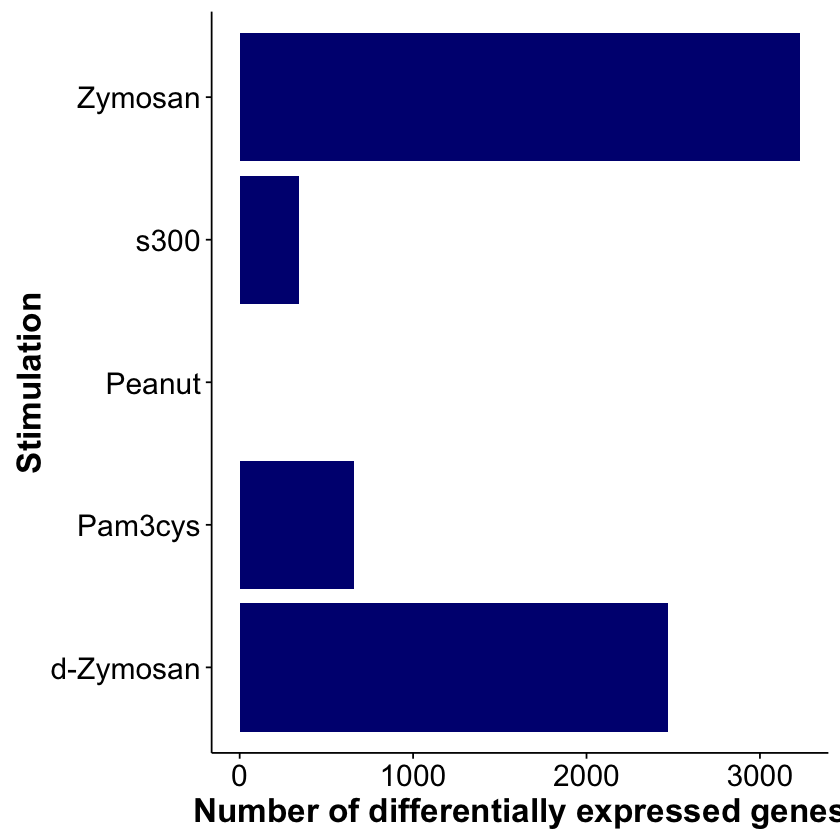

In [43]:
ggplot(data = df_stims, aes(x = rowname, y = nSigGenes_DiffExp)) + 
geom_bar(stat="identity", fill="navy") +
labs(y="Number of differentially expressed genes", x="Stimulation") +theme(
        axis.title=element_text(size=20,face="bold"), axis.text=element_text(size=18)) + coord_flip()

In [44]:
?topTags

In [125]:
pam3cys_vs_s300_lrt <-glmLRT(fit, contrast=c(0,0,0,0,1,0,-1,0))


In [45]:
zym_vs_dzym_lrt <-glmLRT(fit, contrast=c(0,0,0,-1,0,0,0,1))
zym_vs_pam3cys_lrt <-glmLRT(fit, contrast=c(0,0,0,0,-1,0,0,1))

In [46]:
topTags(pam3cys_lrt, n=NULL)$table["MYD88",]


,logFC,logCPM,LR,PValue,FDR
MYD88,-0.3763707,6.734782,2.164905,0.1411933,0.9851361


In [634]:
topTags(zym_lrt, n=100)$table

,logFC,logCPM,LR,PValue,gene,Entrez,FDR
CKB,8.559316,8.759548,211.1002,7.903791e-48,CKB,1152,3.945177e-43
GCKR,6.543987,5.218601,184.5060,5.030967e-42,GCKR,2646,1.255604e-37
IL1A,8.207402,6.204865,180.2670,4.237716e-41,IL1A,3552,7.050853e-37
SSTR2,6.589474,3.774750,179.4889,6.266425e-41,SSTR2,6752,7.819715e-37
EBI3,5.664373,8.083863,178.4009,1.082881e-40,EBI3,10148,1.081040e-36
IL1B,7.775557,10.009446,168.1505,1.875527e-38,IL1B,3553,1.560282e-34
CD80,5.489325,5.800142,167.7793,2.260530e-38,CD80,941,1.611919e-34
FSD1L,4.483497,7.000999,166.6615,3.966194e-38,FSD1L,83856,2.474657e-34
MET,4.941777,3.756049,165.7238,6.356112e-38,MET,4233,3.525170e-34
BAALC,4.350708,6.017969,164.7616,1.031317e-37,BAALC,79870,5.147820e-34


In [47]:
topTags(zym_lrt, n=NULL)$table["NFKB1",]
topTags(dzym_lrt, n=NULL)$table["NFKB1",]
topTags(pam3cys_lrt, n=NULL)$table["NFKB1",]
topTags(s300_lrt, n=NULL)$table["NFKB1",]
topTags(zym_lrt, n=NULL)$table["ALDH1A2",]
topTags(dzym_lrt, n=NULL)$table["ALDH1A2",]
topTags(pam3cys_lrt, n=NULL)$table["ALDH1A2",]
topTags(s300_lrt, n=NULL)$table["ALDH1A2",]

,logFC,logCPM,LR,PValue,FDR
NFKB1,1.877924,8.942344,36.00367,0.000000001969464,0.0000001847853


,logFC,logCPM,LR,PValue,FDR
NFKB1,0.5279387,8.942344,3.003951,0.08306175,0.5131857


,logFC,logCPM,LR,PValue,FDR
NFKB1,0.8994331,8.942344,8.653054,0.003265135,0.1492484


,logFC,logCPM,LR,PValue,FDR
NFKB1,0.3689921,8.942344,1.474246,0.2246769,1


,logFC,logCPM,LR,PValue,FDR
ALDH1A2,1.169049,5.52789,2.219184,0.1363051,0.6322524


,logFC,logCPM,LR,PValue,FDR
ALDH1A2,5.665096,5.52789,40.89013,0.0000000001610326,0.00000003845905


,logFC,logCPM,LR,PValue,FDR
ALDH1A2,-0.352996,5.52789,0.2007384,0.6541255,1


,logFC,logCPM,LR,PValue,FDR
ALDH1A2,6.803299,5.52789,50.4208,0.00000000000124072,0.000000004763886


In [48]:
intersect_tlr2 = intersect(
topTags(zym_vs_dzym_lrt, n=NULL, p.value = 0.05, adjust.method = "BH") %>% .$table %>% rownames,
topTags(pam3cys_lrt, n=NULL, p.value = 0.05, adjust.method = "BH")%>% .$table %>% rownames)

intersect_dect1 = intersect(
topTags(zym_vs_pam3cys_lrt, n=NULL, p.value = 0.05, adjust.method = "BH") %>% .$table %>% rownames,
topTags(dzym_lrt, n=NULL, p.value = 0.05, adjust.method = "BH")%>% .$table %>% rownames)

In [49]:
intersect(intersect_tlr2, intersect_dect1)

[1] "IL6"           "PTGS2"         "IL19"          "IL1A"         
 [5] "WNT5A"         "RP11-701P16.5" "IL36G"         "IL15RA"       
 [9] "IL12B"         "CD200"         "GCKR"          "CKB"          
[13] "IL10"          "EBI3"          "APOL1"         "MMP7"         
[17] "IL1B"          "NPR1"          "LINC00158"     "IER3"         
[21] "MFSD2A"        "TNIP3"         "FSD1L"         "RP4-647J21.1" 
[25] "C1QTNF1"       "SERPINB9"      "ITGB8"         "CD80"         
[29] "MET"           "RP11-367G18.1" "FNDC4"         "RDX"          
[33] "CGN"           "DRAM1"         "TBC1D13"       "PLAGL2"       
[37] "AC005083.1"    "PLAGL1"        "TTC40"         "AQP9"         
[41] "AC008697.1"    "FERMT2"        "MYCL1"         "B4GALT5"      
[45] "ZNRF1"         "SNN"           "ABTB2"         "CSF2"         
[49] "BASP1"         "RP11-81H14.2"  "CCL20"         "IL8"          
[53] "CNKSR3"        "PTX3"          "SERPINB2"      "PDE3B"        
[57] "LIMS2"         "CD274"         "PSD3"          "AICDA"        
[61] "CCR7"          "BMP6"          "NCS1"          "BCL2A1"       
[65] "ICAM1"         "MBNL3"         "ENTHD1"        "GRTP1"        
[69] "CD40"          "LPCAT2"        "TNIP1"         "SPRED2"       
[73] "HPD"           "TSC22D3"       "DUSP5"         "SVEP1"        
[77] "TNF"           "FAM151B"       "SOCS3"         "SMS"          
[81] "AC007362.1"    "GPR137B"       "MIR155HG"      "RIPK2"        
[85] "MARVELD1"      "SLC1A2"        "LINC00515"

In [50]:
only_tlr2 = setdiff(intersect_tlr2, intersect_dect1)
only_dect1 = setdiff(intersect_dect1, intersect_tlr2)


In [527]:
s300_and_tlr2 = intersect(
topTags(s300_lrt, n=NULL, p.value = 0.05, adjust.method = "BH")%>% .$table %>% rownames,
only_tlr2
) %>% as.list

In [526]:
s300_and_dect1 = intersect(
topTags(s300_lrt, n=NULL, p.value = 0.05, adjust.method = "BH")%>% .$table %>% rownames,
only_dect1
) %>% as.list

In [53]:
only_dect1 = only_dect1[-grep("^RP", only_dect1)]
only_tlr2 = only_tlr2[-grep("^RP", only_tlr2)]
intersect_dect1 = intersect_dect1[-grep("^RP", intersect_dect1)]
intersect_tlr2 = intersect_tlr2[-grep("^RP", intersect_tlr2)]

genes common to s300 and zym but not to s300 and dzym include genes involved in tlr7 and il2 stimulation

In [54]:
setdiff(intersect(topTags(dzym_lrt,n=NULL, p.value = 0.05, adjust.method = "BH")$table %>% rownames, topTags(s300_lrt,n=NULL, p.value = 0.05, adjust.method="BH")$table %>% rownames),
        intersect(topTags(zym_lrt,n=NULL, p.value = 0.05, adjust.method="BH")$table %>% rownames, topTags(s300_lrt,n=NULL, p.value = 0.05, adjust.method="BH")$table %>% rownames))  %>% as.list

[[1]]
[1] "GPC4"

[[2]]
[1] "LPL"

[[3]]
[1] "CD109"

[[4]]
[1] "SPOCD1"

[[5]]
[1] "MCOLN3"

[[6]]
[1] "TACSTD2"

[[7]]
[1] "HOMER1"

[[8]]
[1] "GREM1"

[[9]]
[1] "TNFSF14"

[[10]]
[1] "EMP1"

[[11]]
[1] "DAB2"

[[12]]
[1] "TLR5"

[[13]]
[1] "ITGAM"

[[14]]
[1] "ALDH1A2"

[[15]]
[1] "MATK"

[[16]]
[1] "AC007880.1"

[[17]]
[1] "SPRY2"

[[18]]
[1] "C11orf45"

[[19]]
[1] "PPARG"

[[20]]
[1] "ITGA7"

[[21]]
[1] "ENC1"

[[22]]
[1] "LONRF3"

[[23]]
[1] "NPR1"

[[24]]
[1] "PHLDA1"

[[25]]
[1] "CDCP1"

[[26]]
[1] "ENHO"

[[27]]
[1] "TM4SF19"

[[28]]
[1] "SLC17A5"

[[29]]
[1] "FA2H"

[[30]]
[1] "AC091492.2"

[[31]]
[1] "FCER2"

[[32]]
[1] "MFSD12"

[[33]]
[1] "FKBP1A"

[[34]]
[1] "UCHL1"

[[35]]
[1] "GPC1"

[[36]]
[1] "HSPB7"

[[37]]
[1] "ST3GAL6-AS1"

[[38]]
[1] "LRRC8A"

[[39]]
[1] "DPYSL2"

[[40]]
[1] "SH3RF3"

[[41]]
[1] "TCTEX1D2"

[[42]]
[1] "TM7SF4"

[[43]]
[1] "CD1B"

[[44]]
[1] "ATP1B1"

[[45]]
[1] "AC007386.2"

[[46]]
[1] "CCND2"

[[47]]
[1] "TMEM241"

[[48]]
[1] "WNT10B"

[[49]]
[1] "HECTD2"

[[50]]
[1] "DOCK3"

[[51]]
[1] "TCTN3"

[[52]]
[1] "ST7"

[[53]]
[1] "RAPH1"

[[54]]
[1] "CTNS"

[[55]]
[1] "LRTM2"

[[56]]
[1] "PFKP"

[[57]]
[1] "PARVB"

[[58]]
[1] "KCNE1"

[[59]]
[1] "RRP12"

[[60]]
[1] "CHST11"

[[61]]
[1] "HIVEP3"

[[62]]
[1] "FGR"

[[63]]
[1] "IL28RA"

[[64]]
[1] "SH3BP2"

[[65]]
[1] "SLC7A8"

[[66]]
[1] "ANXA11"

[[67]]
[1] "PPP2R3A"

[[68]]
[1] "CDK14"

[[69]]
[1] "SMPD1"

[[70]]
[1] "ZMYND8"

[[71]]
[1] "PTGER3"

[[72]]
[1] "SNHG3"

[[73]]
[1] "PITX1"

[[74]]
[1] "TIE1"

[[75]]
[1] "CLN8"

[[76]]
[1] "KCNJ1"

[[77]]
[1] "SLC29A3"

[[78]]
[1] "SPSB1"

[[79]]
[1] "KCNA10"

[[80]]
[1] "UBTD1"

[[81]]
[1] "SDSL"

[[82]]
[1] "HAVCR2"

[[83]]
[1] "SLC1A4"

[[84]]
[1] "ATP1A1"

[[85]]
[1] "COL4A2"

[[86]]
[1] "ODC1"

[[87]]
[1] "PEX19"

[[88]]
[1] "TIAM1"

[[89]]
[1] "LRRC16B"

[[90]]
[1] "EIF4G3"

[[91]]
[1] "GPATCH4"

[[92]]
[1] "TNFRSF8"

[[93]]
[1] "FCGR2B"

[[94]]
[1] "GIPC3"

[[95]]
[1] "TBX21"

[[96]]
[1] "COL6A1"

[[97]]
[1] "JARID2"

[[98]]
[1] "DNAJB5"

[[99]]
[1] "TNFRSF21"

[[100]]
[1] "TOMM40"

 [ reached getOption("max.print") -- omitted 10 entries ]

In [55]:
intersect_tlr2 %>% length
intersect_dect1 %>% length
only_tlr2 %>% length
only_dect1 %>% length

[1] 181

[1] 537

[1] 98

[1] 454

In [56]:
lapply(lrtlist_singlediff, topTags)

,logFC,logCPM,LR,PValue,FDR
RPLP0P2,5.986829,5.062636,125.2116,4.574741e-29,2.283482e-24
TGM2,5.107226,6.594867,119.1454,9.732666e-28,2.429030e-23
RSAD2,4.925584,6.570220,114.0011,1.302356e-26,1.684522e-22
SSTR2,5.239774,3.774750,113.9300,1.349913e-26,1.684522e-22
IL1RN,5.195344,9.364175,107.8033,2.968165e-25,2.963119e-21
PDGFA,3.300288,4.439927,106.7273,5.108283e-25,3.702595e-21
GEM,3.196818,5.233344,106.6950,5.192461e-25,3.702595e-21
FLT1,4.802963,4.116241,106.3118,6.299961e-25,3.930782e-21
TIMP3,4.081936,6.589949,104.3210,1.720530e-24,9.542249e-21
SERPINB2,6.005602,5.133234,100.8017,1.016704e-23,5.074880e-20


In [57]:

d1_dzym_edger = read.delim("EdgeR//D1_NS_vs_D1_DZymosan.edgeR.tsv", header=T, row.names=1)
d2_dzym_edger = read.delim("EdgeR//D2_NS_vs_D2_DZymosan.edgeR.tsv", header=T, row.names=1)
d3_dzym_edger = read.delim("EdgeR//D3_NS_vs_D3_DZymosan.edgeR.tsv", header=T, row.names=1)


d1_pam3cys_edger = read.delim("EdgeR//D1_NS_vs_D1_Pam3Cys.edgeR.tsv", header=T, row.names=1)
d2_pam3cys_edger = read.delim("EdgeR//D2_NS_vs_D2_Pam3Cys.edgeR.tsv", header=T, row.names=1)
d3_pam3cys_edger = read.delim("EdgeR//D3_NS_vs_D3_Pam3Cys.edgeR.tsv", header=T, row.names=1)


d1_peanut_edger = read.delim("EdgeR//D1_NS_vs_D1_Peanut.edgeR.tsv", header=T, row.names=1)
d2_peanut_edger = read.delim("EdgeR//D2_NS_vs_D2_Peanut.edgeR.tsv", header=T, row.names=1)
d3_peanut_edger = read.delim("EdgeR//D3_NS_vs_D3_Peanut.edgeR.tsv", header=T, row.names=1)


d1_s300_edger = read.delim("EdgeR//D1_NS_vs_D1_S300.edgeR.tsv", header=T, row.names=1)
d2_s300_edger = read.delim("EdgeR//D2_NS_vs_D2_S300.edgeR.tsv", header=T, row.names=1)
d3_s300_edger = read.delim("EdgeR//D3_NS_vs_D3_S300.edgeR.tsv", header=T, row.names=1)


d1_zym_edger = read.delim("EdgeR//D1_NS_vs_D1_Zymosan.edgeR.tsv", header=T, row.names=1)
d2_zym_edger = read.delim("EdgeR//D2_NS_vs_D2_Zymosan.edgeR.tsv", header=T, row.names=1)
d3_zym_edger = read.delim("EdgeR//D3_NS_vs_D3_Zymosan.edgeR.tsv", header=T, row.names=1)



In [58]:
ENTREZ =  toTable(org.Hs.egSYMBOL)
head(ENTREZ)


gene_id,symbol
1,A1BG
2,A2M
3,A2MP1
9,NAT1
10,NAT2
11,NATP


In [59]:
     s300_lrt$table$gene = rownames(s300_lrt$table)
    match_id = match(s300_lrt$table$gene, ENTREZ$symbol)
    s300_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [60]:
dzym_lrt$table$gene = rownames(dzym_lrt$table)
    match_id = match(dzym_lrt$table$gene, ENTREZ$symbol)
    dzym_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [61]:

zym_lrt$table$gene = rownames(zym_lrt$table)
    match_id = match(zym_lrt$table$gene, ENTREZ$symbol)
    zym_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [62]:

pam3cys_lrt$table$gene = rownames(pam3cys_lrt$table)
    match_id = match(pam3cys_lrt$table$gene, ENTREZ$symbol)
    pam3cys_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [63]:
dzym_go = goana(dzym_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")

zym_go = goanaQuick(zym_lrt)
s300_go = goana(s300_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")

pam3cys_go = goana(pam3cys_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")


In [64]:
zym_go = goanaQuick(zym_lrt)
s300_go = goanaQuick(s300_lrt)
pam3cys_go = goanaQuick(pam3cys_lrt)


In [65]:
head(s300_go)

,Term,Ont,N,Up,Down,P.Up,P.Down
GO:0008150,biological_process,BP,15855,246,40,0.060060006,0.35290517309
GO:0001775,cell activation,BP,952,25,11,0.004802356,0.00001244123
GO:0001867,"complement activation, lectin pathway",BP,9,1,0,0.127351251,1.00000000000
GO:0001868,"regulation of complement activation, lectin pathway",BP,2,1,0,0.029812123,1.00000000000
GO:0001869,"negative regulation of complement activation, lectin pathway",BP,2,1,0,0.029812123,1.00000000000
GO:0002252,immune effector process,BP,778,16,8,0.126968241,0.00050672809


In [66]:
golist_singlediff = list(dzym_go, pam3cys_go, s300_go, zym_go)

In [67]:
dzym_ke = kegga(dzym_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")

zym_ke = kegga(dzym_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")

s300_ke = kegga(dzym_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")

pam3cys_ke = kegga(dzym_lrt, geneid = dzym_lrt$table$Entrez, FDR = 0.05, species = "Hs")


In [68]:
bigcomp_ke = keggaQuick(s300_dzym_vs_pam3cys_zym_lrt)

In [70]:
s300_dzym_vs_pam3cys_zym_lrt$table$gene = rownames(s300_dzym_vs_pam3cys_zym_lrt$table)
    match_id = match(s300_dzym_vs_pam3cys_zym_lrt$table$gene, ENTREZ$symbol)
    s300_dzym_vs_pam3cys_zym_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [127]:
smallcomp_ke = keggaQuick(pam3cys_vs_s300_lrt)

In [130]:
topTags(pam3cys_vs_s300_lrt, n=NULL, p.value = 0.05)

,logFC,logCPM,LR,PValue,gene,Entrez,FDR
GPC4,-4.049933,6.094144,98.30428,3.587890e-23,GPC4,2239,1.790895e-18
IL6,7.466043,5.198199,92.87206,5.578651e-22,IL6,3569,1.392292e-17
APOE,-3.707072,4.158124,91.54902,1.088618e-21,APOE,348,1.397913e-17
IGDCC4,3.136261,4.052263,91.49237,1.120235e-21,IGDCC4,57722,1.397913e-17
CXCL1,5.307953,6.096307,90.08182,2.285116e-21,CXCL1,2919,2.281232e-17
LPL,-4.195931,7.781808,82.70567,9.522765e-20,LPL,4023,7.922147e-16
WNT5A,3.659562,6.381053,81.99537,1.364056e-19,WNT5A,7474,9.070804e-16
SPOCD1,-4.629012,3.333390,81.86944,1.453800e-19,SPOCD1,90853,9.070804e-16
RAMP1,-3.766437,3.606589,78.85291,6.691075e-19,RAMP1,10267,3.710945e-15
TIMP3,-3.256835,6.589949,75.91360,2.963525e-18,TIMP3,7078,1.479244e-14


In [126]:
pam3cys_vs_s300_lrt$table$gene = rownames(pam3cys_vs_s300_lrt$table)
    match_id = match(pam3cys_vs_s300_lrt$table$gene, ENTREZ$symbol)
    pam3cys_vs_s300_lrt$table$Entrez = ENTREZ$gene_id[match_id]

In [71]:
zym_vs_dzym_ke = keggaQuick(zym_vs_dzym_lrt)

In [72]:
zym_vs_dzym_lrt

,DonorDonor_1,DonorDonor_2,DonorDonor_3,StimulationDzymosan,StimulationPam3Cys,StimulationPeanut,StimulationS300,StimulationZymosan
5S_rRNA,-16.708958,-15.759612,-16.273564,-1.20307882,-0.474800422,-1.233293963,-0.6452083941,-0.86278006
7SK,-10.561649,-10.260545,-10.925946,-0.10145911,-0.068838091,-0.001499158,-0.2437054221,-0.22784168
A1BG,-12.157709,-12.399445,-12.282465,-0.21743834,0.157964027,0.210587459,0.0418554595,0.05836581
A1CF,-15.759909,-14.369279,-16.287398,0.41421607,0.111304089,0.719628119,-0.4538906997,0.44306014
A2LD1,-13.459180,-13.086416,-14.333306,-1.24933961,-0.312252852,-0.028072630,-0.3964482598,-0.84200744
A2M,-9.182480,-9.260060,-9.401855,-0.08470342,-0.941001790,0.145660926,1.4008937011,-1.41808719
A2ML1,-13.600395,-13.933268,-13.817833,1.16538157,0.922848121,0.221672201,0.6755756716,0.97229275
A2ML1-AS1,-16.900762,-17.086859,-15.999717,-0.06957243,-0.761478932,-0.762529154,-0.7643426596,0.26031315
A2ML1-AS2,-15.934530,-16.066913,-16.847432,1.13734071,-0.133904505,-1.206163722,-1.1720751942,-1.22357925
A2MP1,-13.911436,-10.877149,-14.089582,-0.68673248,-0.743393204,-0.227681228,-0.4712772170,-0.61913850


In [541]:
ls()

[1] "addEntrezToLRT"               "aldh1a2_corgenes"            
  [3] "aldh1a2_neg"                  "aldh1a2_pos"                 
  [5] "auto.loads"                   "cor_genes"                   
  [7] "corg"                         "corr_genes"                  
  [9] "counts"                       "counts_spl"                  
 [11] "counts.tmm"                   "counts2k"                    
 [13] "cpm"                          "d1_dzym_edger"               
 [15] "d1_pam3cys_edger"             "d1_peanut_edger"             
 [17] "d1_s300_edger"                "d1_zym_edger"                
 [19] "d2_dzym_edger"                "d2_pam3cys_edger"            
 [21] "d2_peanut_edger"              "d2_s300_edger"               
 [23] "d2_zym_edger"                 "d3_dzym_edger"               
 [25] "d3_pam3cys_edger"             "d3_peanut_edger"             
 [27] "d3_s300_edger"                "d3_zym_edger"                
 [29] "design"                       "df_stims"                    
 [31] "dge"                          "Donor"                       
 [33] "dzym_go"                      "dzym_ke"                     
 [35] "dzym_lrt"                     "ensembl"                     
 [37] "ENTREZ"                       "filterCpmRank"               
 [39] "fit"                          "getDesignMatrixFromMetaData" 
 [41] "getEdgerCPM"                  "getGenesOfPathways"          
 [43] "getGLMFit"                    "getGLMQLFit"                 
 [45] "getPathNamesFromKe"           "gl_dzym_pi3k"                
 [47] "goanaQuick"                   "golist_singlediff"           
 [49] "int_genes"                    "intersect_dect1"             
 [51] "intersect_tlr2"               "k1"                          
 [53] "k2"                           "keggaQuick"                  
 [55] "kelist_singlediff"            "list_names"                  
 [57] "lrtlist_singlediff"           "match_id"                    
 [59] "metadata"                     "nfkb_fdrs"                   
 [61] "nfkb_kegg"                    "nfkb_logfcs"                 
 [63] "nfkb_sig"                     "numSigGenes"                 
 [65] "only_dect1"                   "only_tlr2"                   
 [67] "order"                        "pam3cys_go"                  
 [69] "pam3cys_ke"                   "pam3cys_lrt"                 
 [71] "pam3cys_vs_s300_lrt"          "peanut_lrt"                  
 [73] "plotDoubleDiffScatterPlot"    "plotInterestingHeatmap"      
 [75] "plotMetricBarplot"            "plotMetricBarplot2"          
 [77] "plotPathways"                 "plotRawCounts"               
 [79] "plotRawCountsMetadata"        "pparfdrtable"                
 [81] "ppargenes"                    "pparlfctable"                
 [83] "pparsigtable"                 "ppartables"                  
 [85] "qc.table"                     "qc.table.long"               
 [87] "qc.table.percent"             "rp"                          
 [89] "runInitSeurat"                "s300_and_dect1"              
 [91] "s300_and_tlr2"                "s300_dzym_vs_pam3cys_zym_lrt"
 [93] "s300_go"                      "s300_ke"                     
 [95] "s300_lrt"                     "seu"                         
 [97] "showcors"                     "smallcomp_ke"                
 [99] "Stimulation"                  "toptags_list"                
 [ reached getOption("max.print") -- omitted 5 entries ]

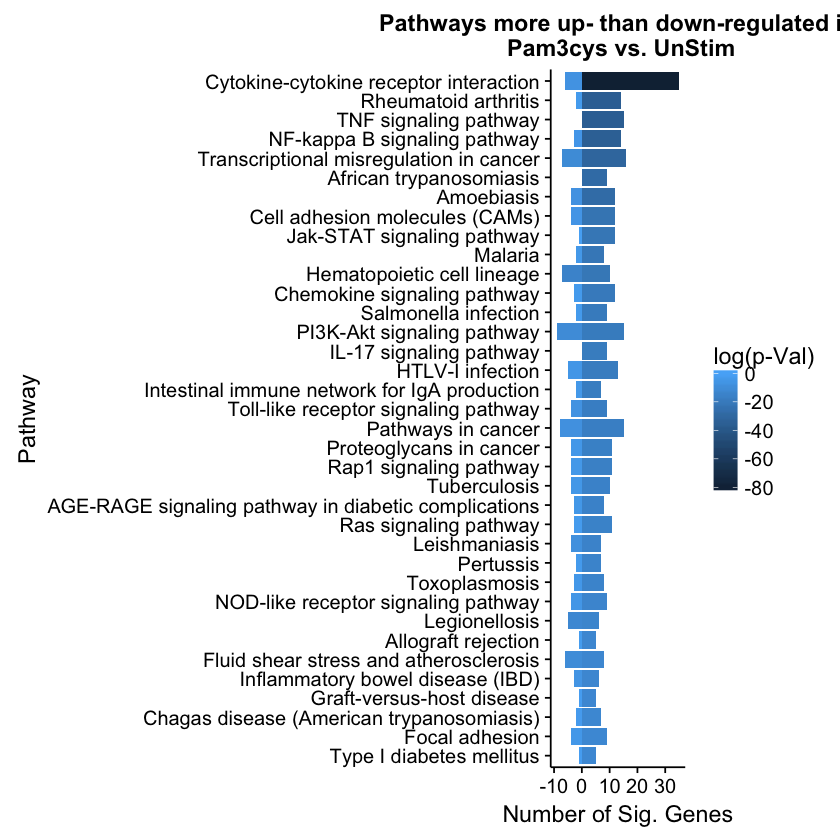

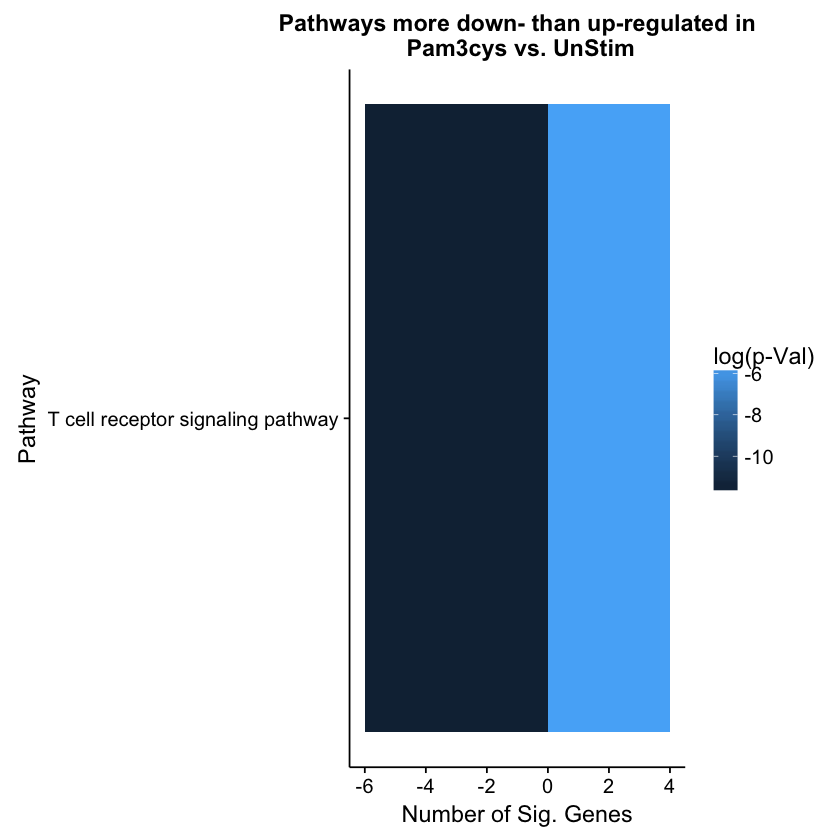

In [552]:
plotPathways(pam3cys_ke, "Pam3cys vs. UnStim")

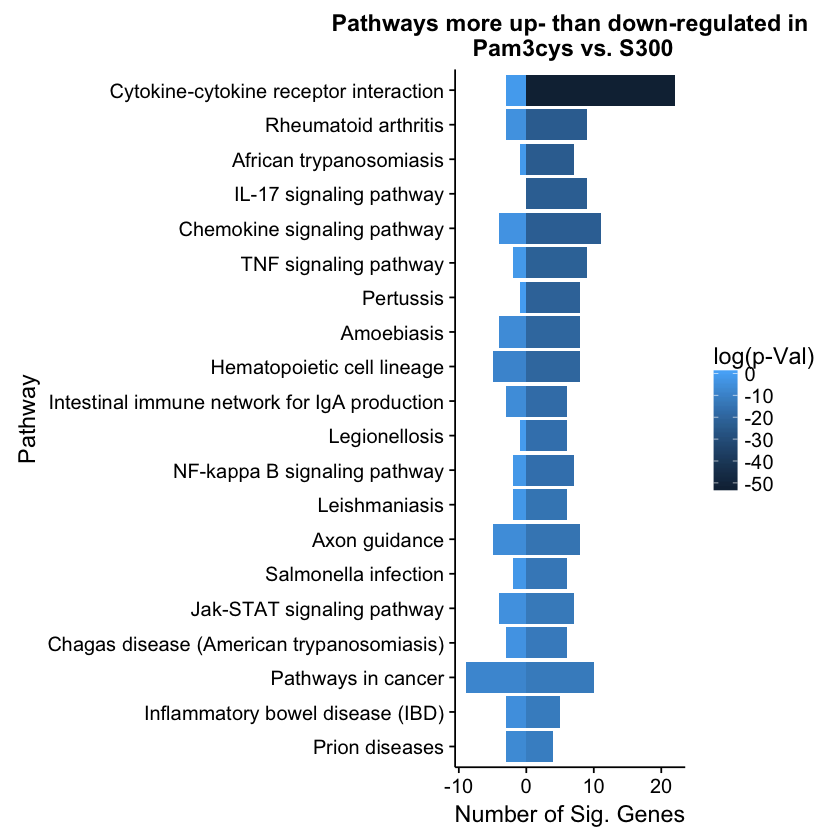

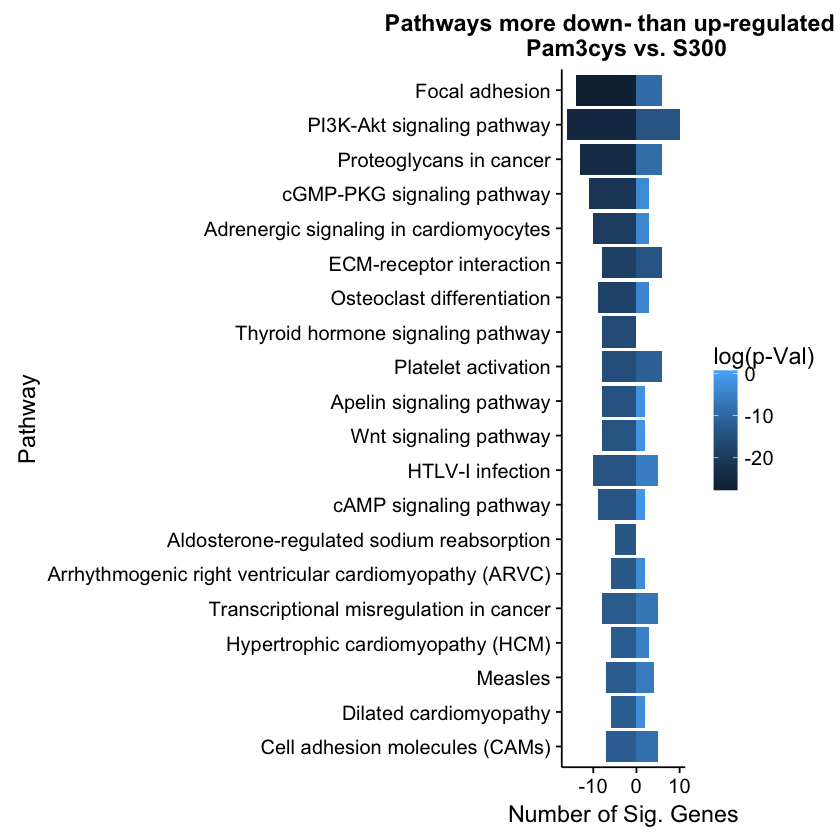

In [132]:
plotPathways(smallcomp_ke, ptitle="Pam3cys vs. S300")

In [74]:
bigcomp_ke %>% filter(N < 500 & P.Down < 10e-5 & Up <Down ) %>% dplyr::arrange(P.Down)

In [75]:
bigcomp_ke %>% filter(N < 500 & P.Up < 10e-5 & Up > Down ) %>% dplyr::arrange(P.Up)

In [76]:
pheatmap(counts.tmm[getGenesOfPathways("path:hsa04064", s300_dzym_vs_pam3cys_zym_lrt),])

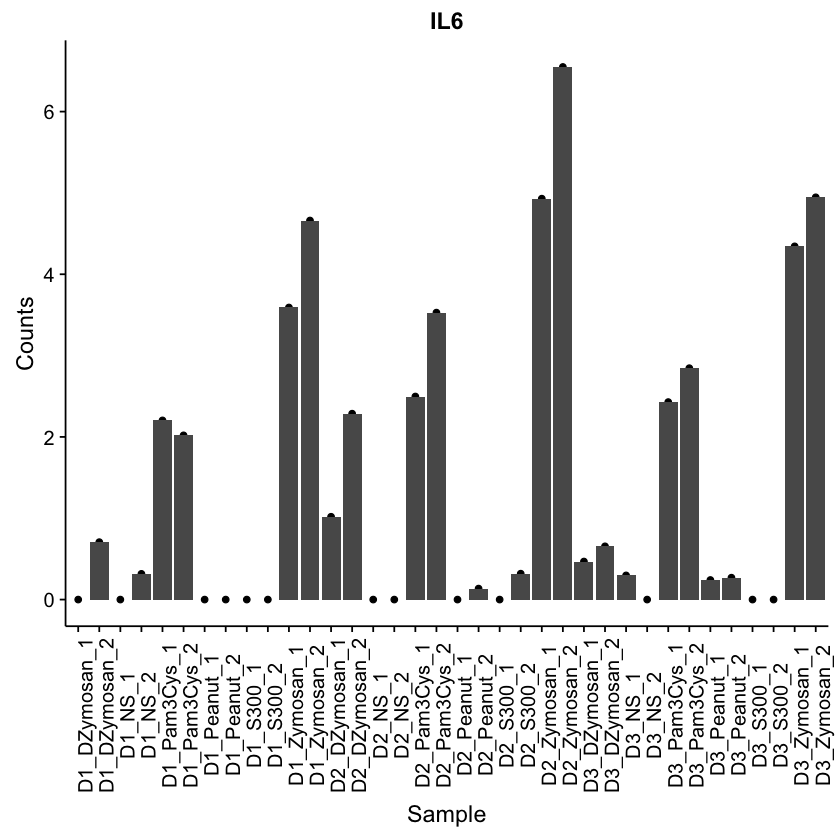

In [78]:
plotRawCounts( "IL6", counts.tmm)

In [79]:
zym_ke = keggaQuick(zym_lrt)
s300_ke = keggaQuick(s300_lrt)
pam3cys_ke = keggaQuick(pam3cys_lrt)

In [80]:
kelist_singlediff = list(dzym_ke, pam3cys_ke, s300_ke, zym_ke)

In [81]:
getPathNamesFromKe <- function(ke) {
    ke %>% filter(P.Up < 10e-4 & P.Down < 10e-4) %>% .$Pathway
    }

In [82]:
counts2k = counts.tmm[order(rowSums(counts.tmm), decreasing = T),] %>% head(10000)

In [83]:
tail(rowSums(counts2k[]))

LCAT     A1BG   LZTFL1     PAOX     CDC7  SERINC2 
62.06655 62.06460 62.06436 62.02481 62.01831 62.01387

In [84]:
rowSums(counts.tmm["ALDH1A2",])

ALDH1A2 
74.45669

In [85]:
corg = cor(t(counts2k))

In [86]:
head(corg)

,AC098691.1,J01415.4,RN28S1,AC079949.1,AC110615.1,AP001347.1,AL161626.1,AC091047.1,MT-ND4,B2M,⋯,PINK1,PARP16,C20orf196,RAB39A,LCAT,A1BG,LZTFL1,PAOX,CDC7,SERINC2
AC098691.1,1.0000000,0.7583655,0.9931313,0.9956783,0.9993291,0.9982450,0.9962240,0.9849999,-0.0112013244,-0.7138295,⋯,0.8305886,-0.06696952,-0.08841646,0.3925589,0.6716741,0.18063175,-0.5720298,0.6750677,-0.5644453,0.2654105
J01415.4,0.7583655,1.0000000,0.7464845,0.7868705,0.7669587,0.7599207,0.7779277,0.7042054,-0.0309679806,-0.4952008,⋯,0.6877804,-0.17497279,-0.28396666,0.3824894,0.4874261,0.06649308,-0.4507824,0.6275981,-0.3811997,0.2226290
RN28S1,0.9931313,0.7464845,1.0000000,0.9827421,0.9908578,0.9882559,0.9842117,0.9910749,-0.0850289277,-0.7611095,⋯,0.8211414,-0.06392347,-0.11456121,0.3865821,0.6624340,0.14551896,-0.6226191,0.6512383,-0.5754433,0.2697552
AC079949.1,0.9956783,0.7868705,0.9827421,1.0000000,0.9976231,0.9959030,0.9990760,0.9678877,0.0152552355,-0.6946750,⋯,0.8218334,-0.08324741,-0.10519698,0.4011422,0.6693819,0.19198389,-0.5537877,0.6944751,-0.5563607,0.2681545
AC110615.1,0.9993291,0.7669587,0.9908578,0.9976231,1.0000000,0.9987243,0.9976491,0.9810713,-0.0001305762,-0.7085378,⋯,0.8253453,-0.07659946,-0.09989907,0.3988673,0.6644448,0.17865810,-0.5718900,0.6855672,-0.5611922,0.2663451
AP001347.1,0.9982450,0.7599207,0.9882559,0.9959030,0.9987243,1.0000000,0.9957651,0.9841088,0.0014506839,-0.7069346,⋯,0.8296723,-0.05195018,-0.08140031,0.3805816,0.6792306,0.17547527,-0.5546611,0.6760121,-0.5388596,0.2507029


In [87]:
aldh1a2_neg = corg[order(corg[, "ALDH1A2"], decreasing=T),"ALDH1A2"] %>% tail(20)

In [89]:
aldh1a2_pos = corg[order(corg[, "ALDH1A2"], decreasing=T),"ALDH1A2"] %>% head(20)

In [90]:
aldh1a2_corgenes = data.frame(c(aldh1a2_neg, aldh1a2_pos))

In [91]:
aldh1a2_corgenes 

,c.aldh1a2_neg..aldh1a2_pos.
RCSD1,-0.6782320
SLA,-0.6783306
PLEKHA2,-0.6857387
EPB41L3,-0.6894856
TAF8,-0.6965152
ADAM28,-0.6971461
ADAMDEC1,-0.7114747
DHTKD1,-0.7138006
NOD2,-0.7156670
ULK1,-0.7224877


In [92]:
colnames(aldh1a2_corgenes) = "cor"

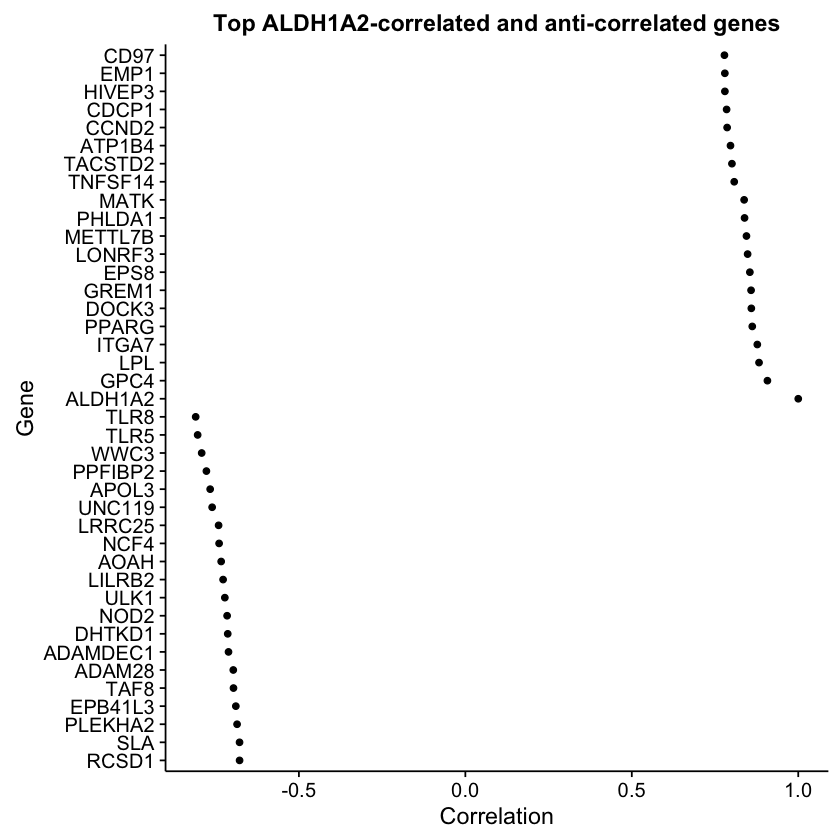

In [93]:
ggplot(aldh1a2_corgenes, aes(x=factor(rownames(aldh1a2_corgenes), levels=rownames(aldh1a2_corgenes)), y=aldh1a2_corgenes$cor)) + geom_point() + coord_flip() + labs(x="Gene",y= "Correlation", title="Top ALDH1A2-correlated and anti-correlated genes")

In [94]:
topTags(s300_lrt, n=NULL)$table["ALDH1A2",]

,logFC,logCPM,LR,PValue,gene,Entrez,FDR
ALDH1A2,6.803299,5.52789,50.4208,0.00000000000124072,ALDH1A2,8854,0.000000004763886


In [95]:
getGenesOfPathways(pam3cys_lrt,"path:hsa04060")
getGenesOfPathways(zym_lrt,"path:hsa04060")

In [96]:
getGenesOfPathways(dzym_lrt,"path:hsa04060")

In [97]:
getGenesOfPathways(s300_lrt,"path:hsa04060" )

In [98]:
intersect(getPathNamesFromKe(s300_ke), getPathNamesFromKe(dzym_ke))

[1] "Cytokine-cytokine receptor interaction"
[2] "Osteoclast differentiation"

In [99]:
setdiff(intersect(getPathNamesFromKe(pam3cys_ke), getPathNamesFromKe(zym_ke)), getPathNamesFromKe(dzym_ke))

[1] "Axon guidance" "Amoebiasis"

In [100]:
k1 = getKEGGPathwayNames(species.KEGG="hsa")
k2 = getGeneKEGGLinks(species.KEGG="hsa", convert=TRUE)

In [101]:
library(biomaRt)
ensembl = useMart("ensembl",dataset="hsapiens_gene_ensembl") #uses human ensembl annotations
#gets gene symbol, transcript_id and go_id for all genes annotated with GO:0007507
gene.data <- getBM(attributes=c('hgnc_symbol', 'ensembl_transcript_id', 'go_id'),
                   filters = 'go_id', values = 'GO:0042573', mart = ensembl)


In [102]:
intersect(gene.data$hgnc_symbol %>% unique,      
          topTags(s300_lrt, n=NULL, p.value = 0.05, adjust.method="BH") %>% rownames
          )

          

In [103]:
intersect_dect1=="G0S2"

[1] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [13] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [25] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [37] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [49] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [61] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [73] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [85] FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE FALSE
 [97] FALSE FALSE FALSE FALSE
 [ reached getOption("max.print") -- omitted 437 entries ]

In [104]:
intersect(
    intersect(intersect_tlr2, intersect_dect1) ,
     topTags(s300_lrt, n=NULL, p.value = 0.05, adjust.method="BH") %>% rownames
          )

[1] "NPR1"      "MFSD2A"    "CNKSR3"    "PSD3"      "BMP6"      "SPRED2"   
 [7] "DUSP5"     "GPR137B"   "SLC1A2"    "LINC00515"

In [105]:
k1[grep("Cyto", k1$Description),]

,PathwayID,Description
123,path:hsa04060,Cytokine-cytokine receptor interaction - Homo sapiens (human)
182,path:hsa04623,Cytosolic DNA-sensing pathway - Homo sapiens (human)


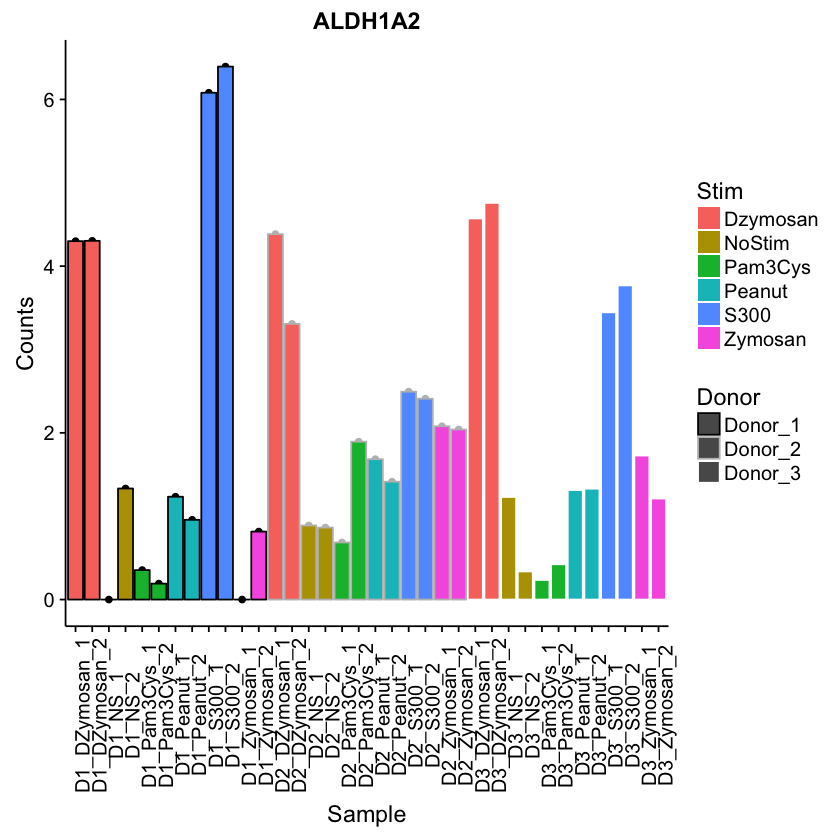

In [294]:
plotRawCounts("ALDH1A2", counts.tmm, metadata)

In [107]:
nfkb_kegg = union(union(getGenesOfPathways("path:hsa04064", s300_lrt),
getGenesOfPathways("path:hsa04064", zym_lrt)),union(
getGenesOfPathways("path:hsa04064", pam3cys_lrt),
    getGenesOfPathways("path:hsa04064", dzym_lrt)))

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"
[1] "NF-kappa B signaling pathway - Homo sapiens (human)"
[1] "NF-kappa B signaling pathway - Homo sapiens (human)"
[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


In [108]:
topTags(dzym_lrt, n=NULL)$table["MALT1",]

,logFC,logCPM,LR,PValue,gene,Entrez,FDR
MALT1,0.9139079,7.126417,11.37784,0.0007432553,MALT1,10892,0.01985052


In [109]:
nfkb_fdrs = data.frame(matrix(nrow=length(nfkb_kegg), ncol=4))
colnames(nfkb_fdrs) = c("dzym", "zym", "s300", "pam3cys")
rownames(nfkb_fdrs) = nfkb_kegg

nfkb_fdrs$dzym = dzym_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$FDR
nfkb_fdrs$zym = zym_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$FDR
nfkb_fdrs$s300 = s300_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$FDR
nfkb_fdrs$pam3cys = pam3cys_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg)  %>% dplyr::arrange(gene) %>% .$FDR

In [110]:
nfkb_logfcs = data.frame(matrix(nrow=length(nfkb_kegg), ncol=4))
colnames(nfkb_logfcs) = c("dzym", "zym", "s300", "pam3cys")
rownames(nfkb_logfcs) = nfkb_kegg

nfkb_logfcs$dzym = dzym_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$logFC
nfkb_logfcs$zym = zym_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$logFC
nfkb_logfcs$s300 = s300_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg) %>% dplyr::arrange(gene) %>% .$logFC
nfkb_logfcs$pam3cys = pam3cys_lrt %>% topTags(n=NULL) %>% .$table %>% filter(gene %in% nfkb_kegg)  %>% dplyr::arrange(gene) %>% .$logFC

In [111]:
nfkb_sig = data.frame(matrix(nrow=length(nfkb_kegg), ncol=4))
nfkb_sig = ifelse(nfkb_fdrs < 0.05, "*", "")

In [112]:
order = c("zym", "pam3cys", "dzym", "s300")

In [113]:
?pheatmap

In [114]:
library(RColorBrewer)

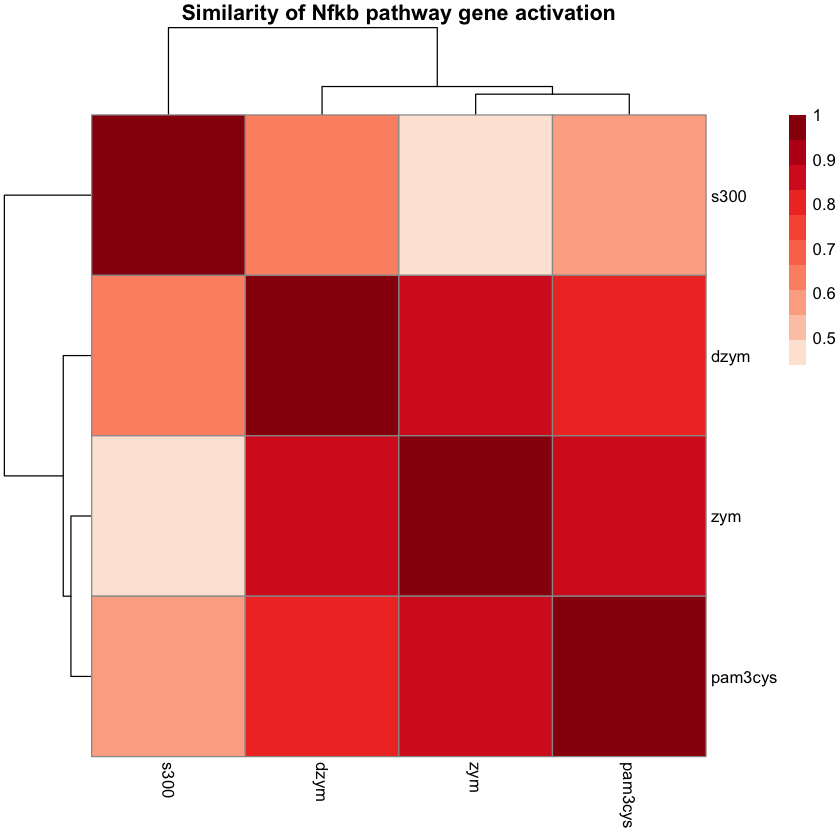

In [115]:
pheatmap(cor(nfkb_logfcs), main="Similarity of Nfkb pathway gene activation",
         color = colorRampPalette((brewer.pal(n = 7, name = "Reds")))(10))

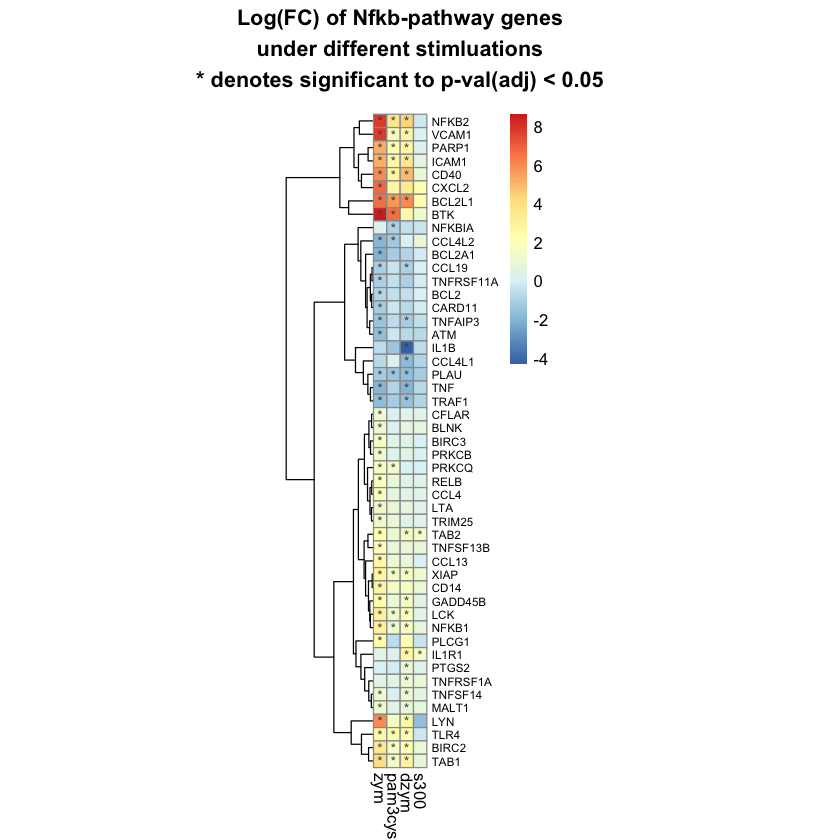

In [116]:
pheatmap(nfkb_logfcs[,order], cellheight=8, cellwidth=8, display_numbers=nfkb_sig[,order], cluster_cols=F, fontsize_row = 7, main="Log(FC) of Nfkb-pathway genes\nunder different stimluations\n* denotes significant to p-val(adj) < 0.05")

In [596]:
getGenesOfPathways("path:hsa04064", dzym_lrt)

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


[1] "PARP1"    "BIRC3"    "XIAP"     "ATM"      "BCL2"     "BCL2A1"  
 [7] "BCL2L1"   "CD14"     "CD40"     "CXCL2"    "ICAM1"    "IL1B"    
[13] "LCK"      "GADD45B"  "PLAU"     "PLCG1"    "PRKCB"    "PRKCQ"   
[19] "PTGS2"    "CCL4"     "CCL13"    "TNF"      "TNFAIP3"  "TNFSF14" 
[25] "CCL4L2"   "TNFSF13B" "MALT1"

In [118]:
topTags(dzym_lrt, n=NULL)$table[getGenesOfPathways("path:hsa04064"),] %>% filter (FDR < 0.05)

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


In [119]:
gl_dzym_pi3k = getGenesOfPathways("path:hsa04151", dzym_lrt)

[1] "PI3K-Akt signaling pathway - Homo sapiens (human)"


In [120]:
str(pam3cys_lrt)

Formal class 'DGELRT' [package "edgeR"] with 1 slot
  ..@ .Data:List of 18
  .. ..$ : num [1:49915, 1:8] -16.7 -10.6 -12.2 -15.8 -13.5 ...
  .. .. ..- attr(*, "dimnames")=List of 2
  .. .. .. ..$ : chr [1:49915] "5S_rRNA" "7SK" "A1BG" "A1CF" ...
  .. .. .. ..$ : chr [1:8] "DonorDonor_1" "DonorDonor_2" "DonorDonor_3" "StimulationDzymosan" ...
  .. ..$ : num [1:49915, 1:36] 4.45e-22 7.11e+01 1.28e+01 5.63e-01 1.17 ...
  .. .. ..- attr(*, "dimnames")=List of 2
  .. .. .. ..$ : chr [1:49915] "5S_rRNA" "7SK" "A1BG" "A1CF" ...
  .. .. .. ..$ : chr [1:36] "D1_DZymosan_1" "D1_DZymosan_2" "D1_NS_1" "D1_NS_2" ...
  .. ..$ : num [1:49915] 0.668 25.084 18.821 23.563 29.522 ...
  .. ..$ : int [1:49915] 23 6 5 15 6 7 8 23 18 9 ...
  .. ..$ : logi [1:49915] FALSE FALSE FALSE FALSE FALSE FALSE ...
  .. ..$ : chr "levenberg"
  .. ..$ : num [1:49915, 1:8] -37.5 -10.6 -12.2 -15.9 -13.5 ...
  .. .. ..- attr(*, "dimnames")=List of 2
  .. .. .. ..$ : chr [1:49915] "5S_rRNA" "7SK" "A1BG" "A1CF" ...
  .. .. .

In [121]:
getGenesOfPathways(pathway = "path:hsa04064")

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


In [123]:
pam3cys_lrt[getGenesOfPathways(pathway = "path:hsa04064"),]

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


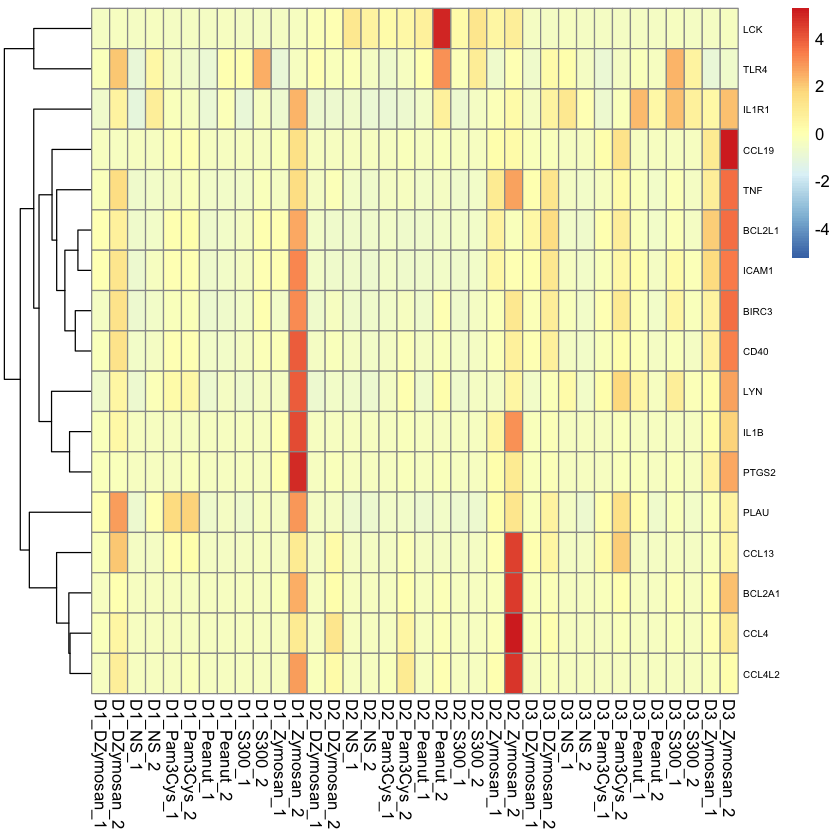

In [124]:
pheatmap(counts[getGenesOfPathways(pathway = "path:hsa04064", pam3cys_lrt),], scale = c("row"), fontsize_row = 6, cluster_cols = F)

In [ ]:
s300_ke["path:hsa04064",]

In [ ]:
getGenesOfPathways(pathway = "path:hsa03320", s300_lrt)

In [ ]:
kelist

In [ ]:
lapply(kelist_singlediff, function (x) topKEGG(x,number=50) %>% tibble::rownames_to_column("pathid") %>% filter(N<1000 & pmin(P.Up, P.Down) < 0.0001) %>% dplyr::select(Pathway))

In [ ]:
plotPathways(s300_ke)

In [ ]:
topke_dzym = topKEGG(dzym_ke, n=20) %>% tibble::rownames_to_column("pathid") %>% filter(N<1000 & pmin(P.Up, P.Down) < 0.0001)
topke_dzym_dn = topke_dzym %>% dplyr::select(pathid, Pathway, Down, P.Down)
topke_dzym_up = topke_dzym %>% dplyr::select(pathid, Pathway, Up, P.Up)
ggplot() + 
    geom_bar(data = topke_dzym_up,aes(x=as.factor(Pathway), y=Up, fill = log(P.Up)),  stat="identity") +
    geom_bar(data = topke_dzym_dn,aes(x=as.factor(Pathway), y=-Down, fill = log(P.Down)),stat = "identity") +
labs(x="Pathway", y="Number of Sig. Genes") + 
 coord_flip()


In [ ]:
head(topke_dzym_up)

In [ ]:
    lapply(golist_singlediff, function (x) topGO(x,,n=100) %>% filter(N<1000 & pmin(P.Up, P.Down) < 0.0001))

In [ ]:
        topKEGG(s300_ke, n=NULL, p.value = 0.05, adjust.method="BH") %>% rownames


In [ ]:
getGenesOfPathways("path:hsa04151", s300_lrt)

In [ ]:
topKEGG(s300_ke)

In [ ]:
topTags(s300_lrt, n=NULL, p.value = 0.05, adjust.method="BH")

In [ ]:
s300_go = goana(s300_lrt, geneid = s300_lrt$table$Entrez, FDR = 0.05, species = "Hs", ont="BP")
s300_ke = kegga(s300_lrt, geneid = s300_lrt$table$Entrez, FDR = 0.05, species = "Hs", ont="BP")


In [ ]:
library(tidyr)

In [ ]:
dzym_go %>% filter(P.Up < 0.01 & N < 200) 

In [ ]:
dzym_go[order(min(dzym_go$P.Up, dzym_go$P.Down)),]
s300_go[order(s300_go$P.Up),] %>% head(10)

In [ ]:
s300_ke[order(pmin(s300_ke$P.Up, s300_ke$P.Down)),]%>% add_rownames %>% filter(N < 500 & (P.Up < 0.0001 | P.Down < 0.0001)) 

In [ ]:
dzym_go

In [495]:
ppargenes = unique(read.delim("ppargenes.txt", header=F)$V1) %>% as.character

In [496]:
setdiff(ppargenes, rownames(ppartables[[1]]))

character(0)

In [497]:
toptags_list = lapply(lrtlist_singlediff, function(x) {topTags(x, n=NULL, adjust.method="BH")$table})

In [498]:
ppartables = lapply(toptags_list, function(x) {x[rownames(x) %in% ppargenes,]})

In [516]:
pparfdrtable = lapply(ppartables, function(x) {as.numeric(x[order(rownames(x)),]$FDR)}) %>% rbind.data.frame %>% as.matrix %>% data.frame
colnames(pparfdrtable)  = list_names
rownames(pparfdrtable) = ppargenes

In [517]:
pparlfctable = lapply(ppartables, function(x) {as.numeric(x[order(rownames(x)),]$logFC)}) %>% rbind.data.frame %>% as.matrix %>% data.frame
colnames(pparlfctable)  = list_names
rownames(pparlfctable) = ppargenes

In [639]:
plotInterestingHeatmap <- function(toptags_list, ppargenes) 
{
    ppartables = lapply(toptags_list, function(x) {x[rownames(x) %in% ppargenes,]})

    pparfdrtable = lapply(ppartables, function(x) {as.numeric(x[order(rownames(x)),]$FDR)}) %>% rbind.data.frame %>% as.matrix %>% data.frame
    colnames(pparfdrtable)  = list_names
    rownames(pparfdrtable) = ppargenes

    pparlfctable = lapply(ppartables, function(x) {as.numeric(x[order(rownames(x)),]$logFC)}) %>% rbind.data.frame %>% as.matrix %>% data.frame
    colnames(pparlfctable)  = list_names
    rownames(pparlfctable) = ppargenes

    pparsigtable = pparfdrtable
    pparsigtable = ifelse(pparsigtable < 0.05, "*", "")

    pheatmap(pparlfctable, display_numbers = pparsigtable, cellheight=5, cellwidth=5, fontsize_row = 5, fontsize_col = 6) 
}

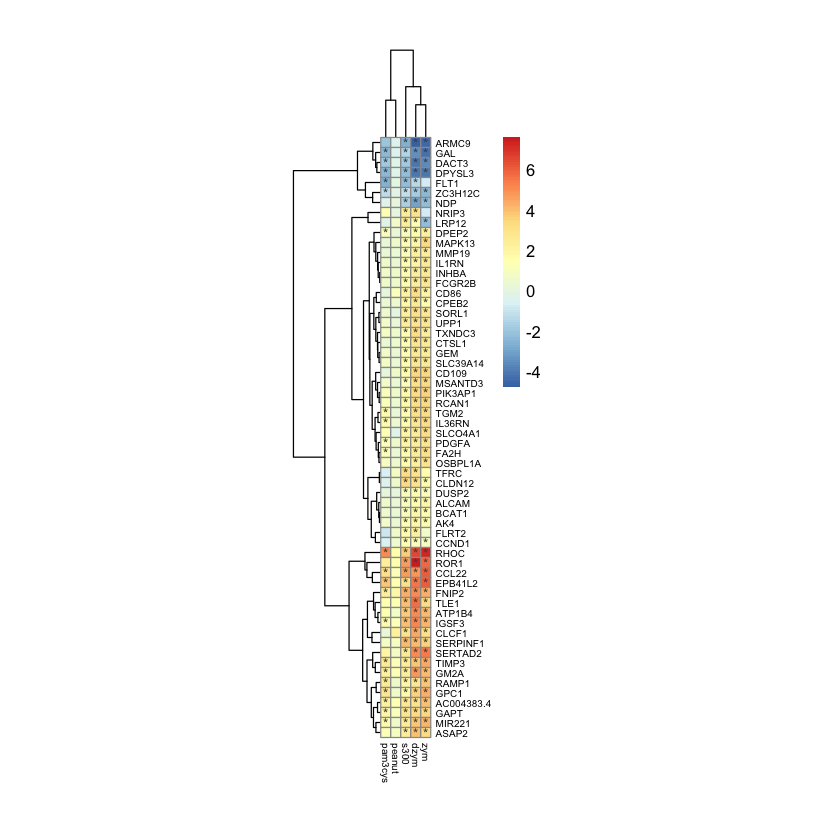

In [539]:
plotInterestingHeatmap(toptags_list, s300_and_dect1)

In [518]:
pparsigtable = pparfdrtable
pparsigtable = ifelse(pparsigtable < 0.05, "*", "")

In [519]:
pparsigtable

,dzym,pam3cys,peanut,s300,zym
CYP27A1,*,*,,*,*
FABP3,,,,,*
ACSL4,*,,,,*
LPL,*,,,,*
MMP1,*,,,,*
PPARG,,,,,*
ACOX3,*,,,,
NR1H3,*,,,*,*
SORBS1,,,,*,*
ACSL6,,,,,*


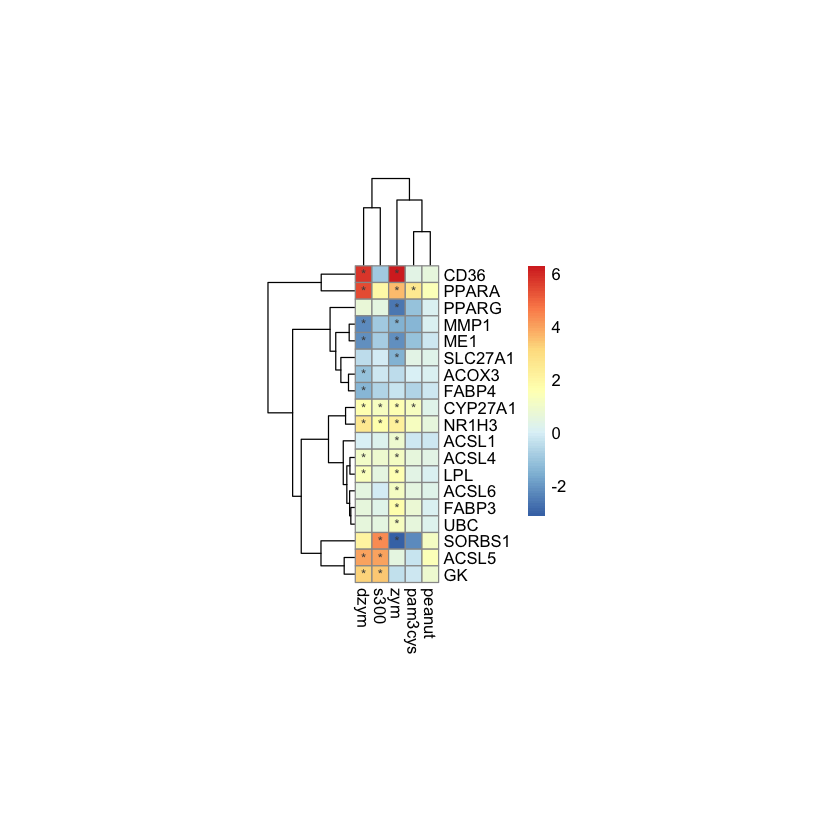

In [521]:
pheatmap(pparlfctable, display_numbers = pparsigtable, cellheight=10, cellwidth=10)

In [553]:
library(wordcloud)

In [556]:
names(toptags_list) = list_names

In [560]:
toptags_list$s300[rownames(toptags_list$s300) %in% s300_and_dect1,]

,logFC,logCPM,LR,PValue,FDR
TIMP3,4.131542,6.5899493,106.67611,5.242069e-25,2.616579e-20
TGM2,4.344847,6.5948671,90.41852,1.927535e-21,4.810645e-17
PDGFA,2.779886,4.4399269,76.49214,2.210917e-18,2.758948e-14
IL1RN,3.901119,9.3641750,68.02074,1.617849e-16,1.345915e-12
RAMP1,3.339296,3.6065891,59.42172,1.272570e-14,7.940039e-11
TLE1,2.342996,5.3244512,50.93060,9.568997e-13,3.980304e-09
GEM,2.139001,5.2333444,50.08821,1.469876e-12,5.240634e-09
CCL22,4.654010,11.7440069,47.50625,5.482879e-12,1.457417e-08
ATP1B4,4.007543,4.0401032,46.88479,7.528478e-12,1.789448e-08
FLRT2,2.426749,4.2903014,41.61834,1.109476e-10,2.215180e-07


In [564]:
s300_and_dect1

[[1]]
[1] "TIMP3"

[[2]]
[1] "TGM2"

[[3]]
[1] "PDGFA"

[[4]]
[1] "IL1RN"

[[5]]
[1] "RAMP1"

[[6]]
[1] "TLE1"

[[7]]
[1] "GEM"

[[8]]
[1] "CCL22"

[[9]]
[1] "ATP1B4"

[[10]]
[1] "FLRT2"

[[11]]
[1] "CCND1"

[[12]]
[1] "SLCO4A1"

[[13]]
[1] "INHBA"

[[14]]
[1] "ALCAM"

[[15]]
[1] "CD109"

[[16]]
[1] "GPC1"

[[17]]
[1] "GAL"

[[18]]
[1] "MSANTD3"

[[19]]
[1] "FCGR2B"

[[20]]
[1] "DUSP2"

[[21]]
[1] "NRIP3"

[[22]]
[1] "FLT1"

[[23]]
[1] "LRP12"

[[24]]
[1] "GM2A"

[[25]]
[1] "MMP19"

[[26]]
[1] "ROR1"

[[27]]
[1] "ARMC9"

[[28]]
[1] "CD86"

[[29]]
[1] "SLC39A14"

[[30]]
[1] "TFRC"

[[31]]
[1] "AC004383.4"

[[32]]
[1] "IGSF3"

[[33]]
[1] "SERTAD2"

[[34]]
[1] "RHOC"

[[35]]
[1] "FA2H"

[[36]]
[1] "SORL1"

[[37]]
[1] "CLCF1"

[[38]]
[1] "CPEB2"

[[39]]
[1] "IL36RN"

[[40]]
[1] "EPB41L2"

[[41]]
[1] "CTSL1"

[[42]]
[1] "ZC3H12C"

[[43]]
[1] "GAPT"

[[44]]
[1] "BCAT1"

[[45]]
[1] "CLDN12"

[[46]]
[1] "MAPK13"

[[47]]
[1] "OSBPL1A"

[[48]]
[1] "MIR221"

[[49]]
[1] "DACT3"

[[50]]
[1] "AK4"

[[51]]
[1] "PIK3AP1"

[[52]]
[1] "ASAP2"

[[53]]
[1] "DPYSL3"

[[54]]
[1] "RCAN1"

[[55]]
[1] "FNIP2"

[[56]]
[1] "SERPINF1"

[[57]]
[1] "UPP1"

[[58]]
[1] "NDP"

[[59]]
[1] "TXNDC3"

[[60]]
[1] "DPEP2"

In [585]:
cols_wc = colorRampPalette(colors=c("black", "grey"))(length(s300_and_dect1))

In [577]:
cols_wc

[1] "#BEBEBE" "#BABABA" "#B7B7B7" "#B4B4B4" "#B1B1B1" "#ADADAD" "#AAAAAA"
 [8] "#A7A7A7" "#A4A4A4" "#A1A1A1" "#9D9D9D" "#9A9A9A" "#979797" "#949494"
[15] "#909090" "#8D8D8D" "#8A8A8A" "#878787" "#848484" "#808080" "#7D7D7D"
[22] "#7A7A7A" "#777777" "#737373" "#707070" "#6D6D6D" "#6A6A6A" "#676767"
[29] "#636363" "#606060" "#5D5D5D" "#5A5A5A" "#565656" "#535353" "#505050"
[36] "#4D4D4D" "#4A4A4A" "#464646" "#434343" "#404040" "#3D3D3D" "#393939"
[43] "#363636" "#333333" "#303030" "#2D2D2D" "#292929" "#262626" "#232323"
[50] "#202020" "#1C1C1C" "#191919" "#161616" "#131313" "#101010" "#0C0C0C"
[57] "#090909" "#060606" "#030303" "#000000"

In [586]:
toptags_list$s300[rownames(toptags_list$s300) %in% s300_and_dect1,] 


,logFC,logCPM,LR,PValue,FDR
TIMP3,4.131542,6.5899493,106.67611,5.242069e-25,2.616579e-20
TGM2,4.344847,6.5948671,90.41852,1.927535e-21,4.810645e-17
PDGFA,2.779886,4.4399269,76.49214,2.210917e-18,2.758948e-14
IL1RN,3.901119,9.3641750,68.02074,1.617849e-16,1.345915e-12
RAMP1,3.339296,3.6065891,59.42172,1.272570e-14,7.940039e-11
TLE1,2.342996,5.3244512,50.93060,9.568997e-13,3.980304e-09
GEM,2.139001,5.2333444,50.08821,1.469876e-12,5.240634e-09
CCL22,4.654010,11.7440069,47.50625,5.482879e-12,1.457417e-08
ATP1B4,4.007543,4.0401032,46.88479,7.528478e-12,1.789448e-08
FLRT2,2.426749,4.2903014,41.61834,1.109476e-10,2.215180e-07


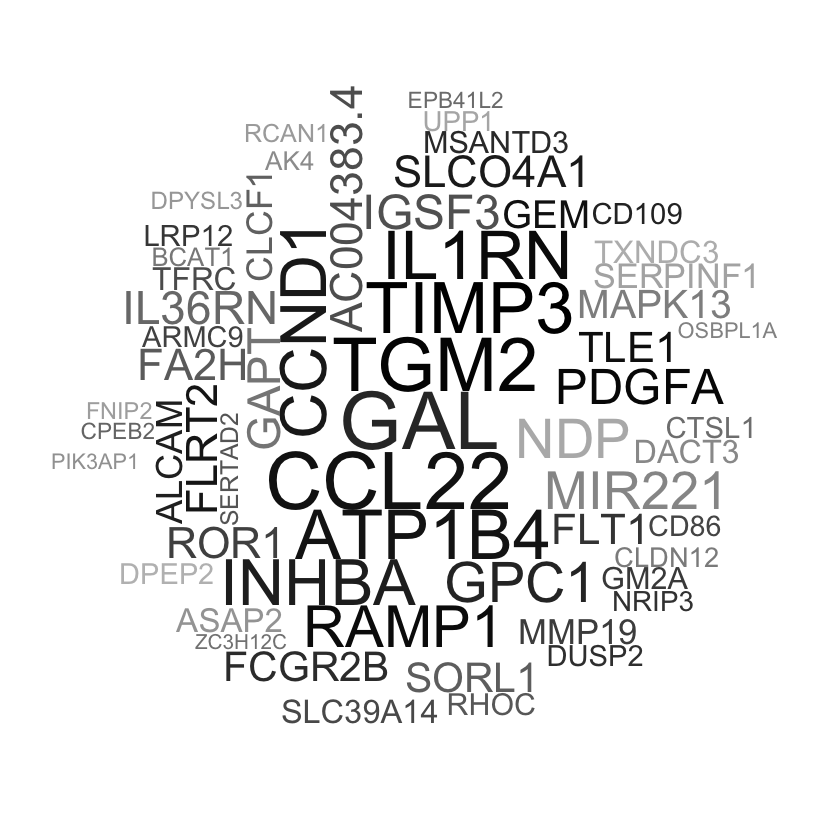

In [595]:
wordcloud(unlist(s300_and_dect1), freq = floor(100*abs(toptags_list$s300[rownames(toptags_list$s300) %in% s300_and_dect1,"logFC"])), 
          rot.per=0.05, random.order=F, colors=cols_wc, ordered.colors=T, scale = c(4,0.2)) 

In [ ]:
getGenesOfPathways

In [600]:
mygenes = getGenesOfPathways("path:hsa04064", pam3cys_vs_s300_lrt)

[1] "NF-kappa B signaling pathway - Homo sapiens (human)"


In [598]:
cols_wc = colorRampPalette(colors=c("black", "grey"))(length(mygenes))

In [622]:
plotGenePathWC <- function(pathway, lrt) {
    genelist = getGenesOfPathways(pathway, lrt)
    toptable = topTags(lrt, n=NULL, p.value=0.05, adjust.method="BH")$table
    cols_wc = colorRampPalette(colors=c("black", "grey"))(length(genelist))
    wordsize = floor(100*abs(toptable[rownames(toptable) %in% genelist, "logFC"]))
    wordcloud(genelist, freq=wordsize, 
          rot.per=0, random.order=F, colors=cols_wc, 
              ordered.colors=T, scale = c(4,0.2)) 
}

In [610]:
mygenes

[1] "CXCL2"   "IL1B"    "LYN"     "PLAU"    "PTGS2"   "CCL13"   "CCL19"  
[8] "TLR4"    "TNFSF14"

In [612]:
head(toptable)

[1] "Wnt signaling pathway - Homo sapiens (human)"


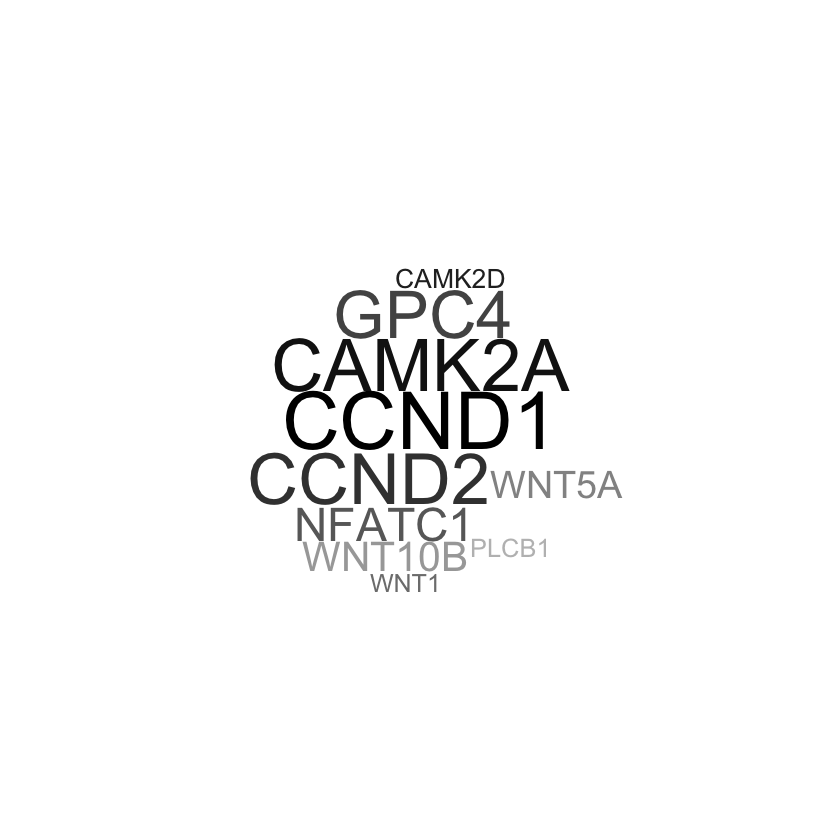

In [632]:
plotGenePathWC("path:hsa04310", pam3cys_vs_s300_lrt)

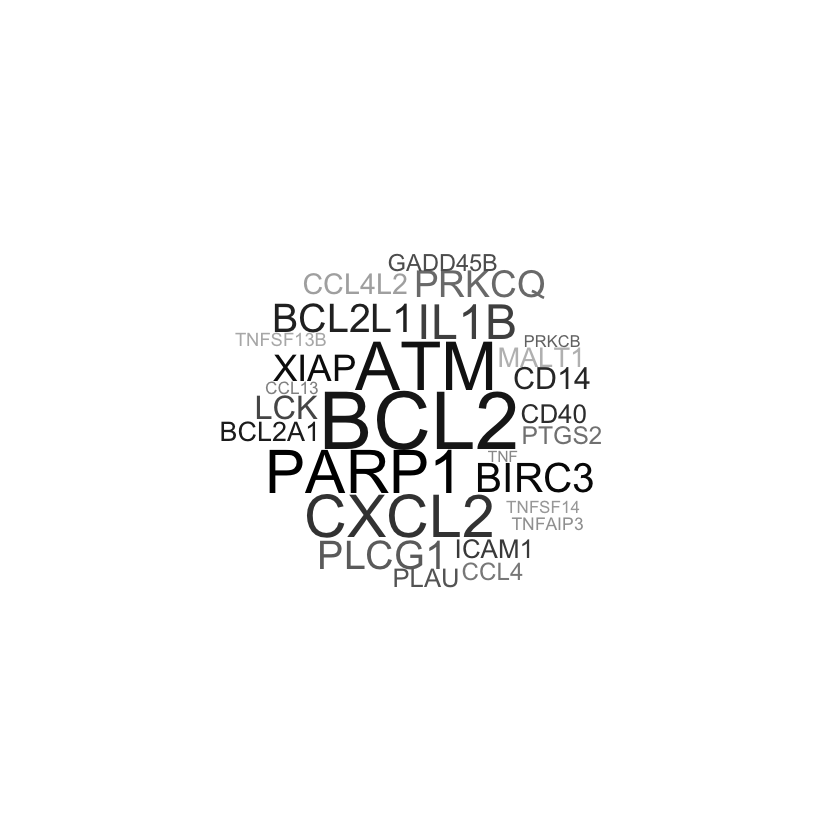

In [599]:
wordcloud(mygenes, freq = floor(100*abs(toptags_list$s300[rownames(toptags_list$dzym) %in% mygenes,"logFC"])), 
          rot.per=0.05, random.order=F, colors=cols_wc, ordered.colors=T, scale = c(4,0.2)) 

In [569]:
floor(100*abs(toptags_list$s300[rownames(toptags_list$s300) %in% s300_and_dect1,"logFC"]))

[1] 413 434 277 390 333 234 213 465 400 242 369 246 369 199 156 320 468 164 228
[20] 155 147 235 156 164 189 241 154 152 176 171 250 271 128 162 244 228 195 115
[39] 259 115 156 103 256 134 144 217 110 299 175 136 109 179 124 130 120 186 146
[58] 313 168 154

In [638]:
fix(plotInterestingHeatmap)

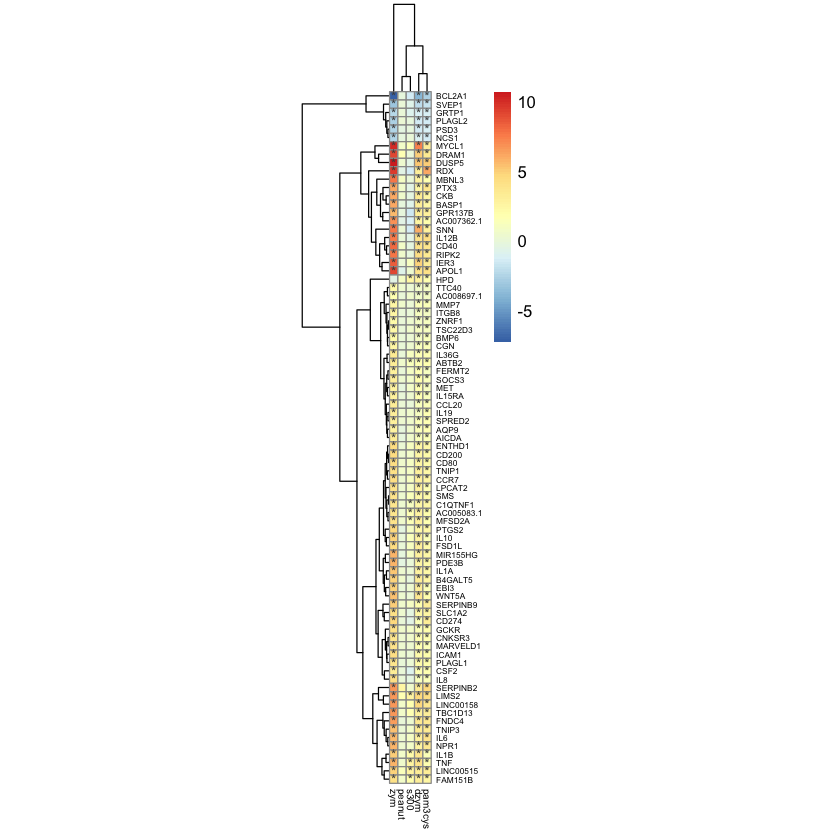

In [640]:
plotInterestingHeatmap(toptags_list, intersect(intersect_dect1, intersect_tlr2))